- This notebook will plot all neuronal cells types(at Group level) for each samples separately. 

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns
import anndata 
import scanpy as sc
sc.settings.n_jobs = 24
sc.settings.set_figure_params(dpi = 180, dpi_save = 300, frameon = False, figsize = (4,4), fontsize=8,facecolor = 'white')



- Utility function for spatial plotting

In [2]:
def plot_cluster_scdata(scdata,cmap,all_clusters,clusters=[1,2],bg_color = 'gray',bg_pt_size = 5, point_sz_map = None, transpose=1,flipx=1,flipy=1,hue_input = 'leiden' , ax = None,use_seaborn = False,show_title = True):
    """
    plot spatial location of cell cluster using either seaborn or matplotlib
    use seaborn for individual clusters
    use matplotlib scatter function to visualize all clusters
    cmap - dictionary that has color of each cluster  used in umap
    """
    fig = None
    if not ax:
     fig,ax = plt.subplots(figsize=(15, 15),)# facecolor="black")

    
    if use_seaborn:
        x,y,hue = 'x', 'y',hue_input
        sns.scatterplot(x=x, y=y, data=scdata.obs, 
                        s=bg_pt_size, markers=dict(marker_edge_color='none'),
                        rasterized=True,
                        ax=ax,c= bg_color)
    else: # use matplotlib
        x,y = (np.array(scdata.obs[['x', 'y']])*[flipx,flipy])[:,::transpose].T
        ax.scatter(x, y, c=bg_color, s = bg_pt_size, marker='.')
        
    for cluster in clusters:
        clst_idx = all_clusters.index(cluster)
        cluster_ = str(cluster)
        inds = scdata.obs[hue_input] == cluster_
        
        #col = cmap[int(clst_idx) % len(cmap)]
        col = cmap[cluster_] # cmap is dictionary
        point_sz = point_sz_map[cluster_] # point size dictionary
        if use_seaborn:
            sns.scatterplot(x=x, y=y, data=scdata.obs[inds], 
                        s=point_sz, markers=dict(marker_edge_color=col),
                        rasterized=True,
                        ax=ax,c= col)
            if show_title:
                ax.set_title(f'cluster {cluster_}',fontsize = 7, y= 1)
        else:
            x_ = x[inds]
            y_ = y[inds]
            ax.scatter(x_, y_, c=col, s= point_sz, marker='.',label = cluster_)
        
        
    
    # ax.set_xlim([x.min(),x.max()])
    # ax.set_ylim([y.min(),y.max()])
    ax.grid(False)
    ax.axis("off")
    ax.axis("equal")
    if fig:
        ax.legend( loc = 'lower center', ncol = len(clusters)//3,markerscale = 12, title = 'Clusters',facecolor = 'black',
            labelcolor = 'white')
        ax.set_title(np.unique(scdata.obs['sample'])[0])
    else:
        # ax.legend( loc = 'lower center')
        pass
        
    ax.autoscale(enable=True, tight=True)
    
   

In [3]:
def rotate(spatial_x,deg):
    """
    spatial_X: Nx2 matrix
    deg: rotation degree in radian
    
    """
    deg = np.deg2rad(deg)
    rotation_mat = np.array([[np.cos(deg),-1*np.sin(deg)],
                            [np.sin(deg),np.cos(deg)]])
    return np.matmul(spatial_x,rotation_mat)

- Load all MERFISH data

In [ ]:
%%time

# load 1311 posterior 
Donor_1311_posterior_adata  = anndata.read_h5ad(r'./../../MERFISH_adata_QC/mapmycell_annotated_adata/MER2_Gpe_Gpi_CaPu_1311__MERFISH_annotated.h5ad')
spatialModuleAnnotation = pd.read_csv(r'./../../spatialDomain_analysis/processed_data/donor_1311_PosteriorMERFISH/GroupLevelspatialModule_MatrixStriosome_included_cleaned_final.csv', index_col=0)
Donor_1311_posterior_adata.obs = Donor_1311_posterior_adata.obs.join(spatialModuleAnnotation[['Final_Major_region_label','MatrixStriosome_label']])
print('load 1311 posterior .....')

# # load 2427 posterior 
Donor_2427_posterior_adata = anndata.read_h5ad(r'./../../MERFISH_adata_QC/mapmycell_annotated_adata/MER4_Gpe_Gpi_2724__MERFISH_annotated.h5ad')
spatialModuleAnnotation = pd.read_csv(r'./../../spatialDomain_analysis/processed_data/donor_2724_PosteriorMERFISH/GroupLevelspatialModule_MatrixStriosome_included_cleaned_final.csv', index_col=0)
Donor_2427_posterior_adata.obs = Donor_2427_posterior_adata.obs.join(spatialModuleAnnotation[['Final_Major_region_label','MatrixStriosome_label']])
print('load 2427 posterior .....')

# # load 2427 anterior 
Donor_2427_anterior_adata = anndata.read_h5ad(r'./../../MERFISH_adata_QC/mapmycell_annotated_adata/MER1_CaPuNAC_2427__MERFISH_annotated.h5ad')
spatialModuleAnnotation = pd.read_csv(r'./../../spatialDomain_analysis/processed_data/chip5_AnteriorMERFISH/GroupLevelspatialModule_MatrixStriosome_included_cleaned_final.csv', index_col=0)
Donor_2427_anterior_adata.obs = Donor_2427_anterior_adata.obs.join(spatialModuleAnnotation[['Final_Major_region_label','MatrixStriosome_label']])
print('load 2427 anterior .....')

# # load 3924 anterior 
Donor_3924_anterior_adata = anndata.read_h5ad(r'./../../MERFISH_adata_QC/mapmycell_annotated_adata/MER5_CaPuNAc_3924__MERFISH_annotated.h5ad')
spatialModuleAnnotation = pd.read_csv(r'./../../spatialDomain_analysis/processed_data/donor_3924_AnteriorMERFISH/GroupLevelspatialModule_MatrixStriosome_included_cleaned_final.csv', index_col=0)
Donor_3924_anterior_adata.obs = Donor_3924_anterior_adata.obs.join(spatialModuleAnnotation[['Final_Major_region_label','MatrixStriosome_label']])
print('load 3924 anterior  .....')

load 1311 posterior .....
load 2427 posterior .....
load 2427 anterior .....
load 3924 anterior  .....
CPU times: user 1min 29s, sys: 17.1 s, total: 1min 46s
Wall time: 1min 53s


- Concatenate the data

- Make sure the same order of genes is used in all samples and replace count with raw counts 

In [5]:
# make sure the same order of genes is used in all samples  and replace count with raw counts
common_gns = np.array(Donor_2427_posterior_adata.var_names)
Donor_1311_posterior_adata.X = Donor_1311_posterior_adata.layers['X_raw']
Donor_1311_posterior_adata = Donor_1311_posterior_adata[:,common_gns].copy()
Donor_1311_posterior_adata.obsm['X_spatial'] = Donor_1311_posterior_adata.obsm['X_spatial_rotated'] if 'X_spatial_rotated'  in Donor_1311_posterior_adata.obsm else Donor_1311_posterior_adata.obsm['X_spatial']

Donor_2427_posterior_adata.X = Donor_2427_posterior_adata.layers['X_raw']
Donor_2427_posterior_adata = Donor_2427_posterior_adata[:,common_gns].copy()
Donor_2427_posterior_adata.obsm['X_spatial'] = Donor_2427_posterior_adata.obsm['X_spatial_rotated'] if 'X_spatial_rotated'  in Donor_2427_posterior_adata.obsm else Donor_2427_posterior_adata.obsm['X_spatial']

Donor_2427_anterior_adata.X = Donor_2427_anterior_adata.obsm['X_raw']
Donor_2427_anterior_adata = Donor_2427_anterior_adata[:,common_gns].copy()
Donor_2427_anterior_adata.obsm['X_spatial'] = Donor_2427_anterior_adata.obsm['X_spatial_rotated'] if 'X_spatial_rotated'  in Donor_2427_anterior_adata.obsm else Donor_2427_anterior_adata.obsm['X_spatial']

Donor_3924_anterior_adata.X = Donor_3924_anterior_adata.layers['X_raw']
Donor_3924_anterior_adata = Donor_3924_anterior_adata[:,common_gns].copy()
Donor_3924_anterior_adata.obsm['X_spatial'] = Donor_3924_anterior_adata.obsm['X_spatial_rotated'] if 'X_spatial_rotated'  in Donor_3924_anterior_adata.obsm else Donor_3924_anterior_adata.obsm['X_spatial']

In [6]:
# concatenate the data
adata_MERFISH = anndata.concat([Donor_1311_posterior_adata,Donor_2427_posterior_adata,Donor_2427_anterior_adata,Donor_3924_anterior_adata],
                       label = 'samples',
                        keys= ['Donor_1311_posterior','Donor_2724_posterior','Donor_2724_anterior','Donor_3924_anterior'],
                        fill_value=0,
                        join='outer',
                        merge='same' ,
                        index_unique='_' # make the cell index unique
                        ) 


- Load the contour for the spatial modules 

In [ ]:
donor_1311_posterior_spatialModuleContours = np.load(r'./../../spatialDomain_analysis/processed_data/donor_1311_PosteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_1311_posterior_StriosomeContours = np.load(r'./../../spatialDomain_analysis/processed_data/donor_1311_PosteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

donor_2427_posterior_spatialModuleContours = np.load(r'./../../spatialDomain_analysis/processed_data/donor_2724_PosteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_2427_posterior_StriosomeContours = np.load(r'./../../spatialDomain_analysis/processed_data/donor_2724_PosteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

donor_2427_anterior_spatialModuleContours = np.load(r'./../../spatialDomain_analysis/processed_data/chip5_AnteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_2427_anterior_StriosomeContours = np.load(r'./../../spatialDomain_analysis/processed_data/chip5_AnteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

donor_3924_anterior_spatialModuleContours = np.load(r'./../../spatialDomain_analysis/processed_data/donor_3924_AnteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_3924_anterior_StriosomeContours = np.load(r'./../../spatialDomain_analysis/processed_data/donor_3924_AnteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

- Define colormap and define point size 

In [ ]:
cluster_cmap = np.load(r'./cluster_cmap_final_updated_9172025.npy', allow_pickle=True).item()

In [9]:
import numpy as np
colors = list(cluster_cmap.values())
np.unique(colors).shape, len(colors)

((58,), 60)

In [10]:
all_clusters = np.unique(adata_MERFISH.obs['Group_name']).tolist()
clusters_curated = [ 

# +++++++++++++ Oligo +++++++++++++++++++++++
'ImOligo','Oligo OPALIN', 'Oligo PLEKHG1',
'COP',
'OPC',
 
# # glia (Astro-Ependy-Immune)
 'Astrocyte',
  'Ependymal',
  'ImAstro',
 'B cells',
 'BAM',
 'Endo',
'VLMC',
'Pericyte',
 'SMC',

# # # ++++++++++++++++ Gp cells  +++++++++++++++++++
 'GPe MEIS2-SOX6 GABA',
 'GPe SOX6-CTXND1 GABA',
 'GPe-NDB-SI LHX6-LHX8-GBX1 GABA',
 'GPi Core',
 'GPi Shell',
 'GPin-BF Cholinergic GABA',

# # +++++++++++++++++ MSN ++++++++++++++++++++++++++++++++
    'STR D1D2 Hybrid MSN',
    'STRd D2 StrioMat Hybrid MSN',
    'STRv D1 NUDAP MSN',
    'STRd D2 Striosome MSN',
    'STRd D2 Matrix MSN',
    'STRd D1 Striosome MSN',
    'STRd D1 Matrix MSN',
    'STRv D2 MSN',
    'STRv D1 MSN',
    
    

    ]

remaining_clusters  = list(set(all_clusters).difference(clusters_curated))

all_clusters = remaining_clusters + clusters_curated

In [11]:
point_sz_map = { 'Oligo OPALIN': 0.2,
                 'Oligo PLEKHG1': 0.5,
                  'COP':0.5,
                  'ImOligo':0.2,
                  'OPC': 0.5,
                'STR D1D2 Hybrid MSN': 2,
                'STRd D2 StrioMat Hybrid MSN': 2,
                'STRv D1 NUDAP MSN':2,
                 'STRd D2 Striosome MSN':0.5,
                 'STRd D1 Striosome MSN':1,
                 'STRd D2 Matrix MSN':1,
                 'STRd D1 Matrix MSN':2,
                 'STRv D1 MSN':2,
                 'STRv D2 MSN':1,
                  'GPi Core':4,
                  'GPi Shell':4,
                   'GPe SOX6-CTXND1 GABA':2,
                   'GPe MEIS2-SOX6 GABA':2,
                   'GPe-NDB-SI LHX6-LHX8-GBX1 GABA':2,
                    'GPin-BF Cholinergic GABA':2,
                   
                    # glia (Astro-Ependy-Immune)
                    'Astrocyte':0.2,
                    'Ependymal':0.2,
                    'ImAstro':0.2,
                    'B cells':0.2,
                    'BAM':0.2,
                    'Endo':0.2,
                    'VLMC': 1,
                     'Pericyte': 0.5,
                     'SMC': 1

                    
                 }

point_sz_map.update({clst:3 for clst in remaining_clusters})

### 1. Spatial plot for each MERFISH sample

- Restrict to neuronal cells 

In [15]:
keep = adata_MERFISH.obs['Neighborhood_name'].isin(['Nonneuron'])
neuron_celltypes = np.unique(adata_MERFISH[~keep].obs['Group_name'])
allneuron_clusters = [clst for clst in all_clusters if clst in neuron_celltypes]

In [16]:
np.unique(adata_MERFISH.obs['samples'])

array(['Donor_1311_posterior', 'Donor_2724_anterior',
       'Donor_2724_posterior', 'Donor_3924_anterior'], dtype=object)

In [14]:
np.unique(adata_MERFISH.obs['Class_name'])

array(['Astro-Epen', 'CN CGE GABA', 'CN GABA-Glut', 'CN LGE GABA',
       'CN MGE GABA', 'Cx GABA', 'F M GABA', 'F M Glut', 'Immune',
       'M Dopa', 'OPC-Oligo', 'Vascular'], dtype=object)

In [15]:
keep = adata_MERFISH.obs['Class_name'].isin(['M Dopa'])
np.unique(adata_MERFISH[keep].obs['Group_name'])

array(['SN SOX6 Dopa', 'SN-VTR CALB1 Dopa', 'SN-VTR GAD2 Dopa'],
      dtype=object)

In [17]:
import seaborn as sns
import matplotlib.patches as patches
import os
rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 

adata_MERFISH.obs[['x','y']] = adata_MERFISH.obsm['X_spatial'].copy()
figsize_scale = 8e3

dx_list = []
dy_list = []
samples = np.unique(adata_MERFISH.obs['samples'])
for i,sample in enumerate(samples):
    cond = adata_MERFISH.obs['samples'] == sample
    # adjucent the spatial coordinate 
    X_sample = adata_MERFISH[cond].obsm['X_spatial'].copy()
    X_sample = rotate(X_sample,rot_deg[sample]) # since rotation is could change the xy limit, perform rotation to get accurate estiamte

    # idenity the proprotion betwen the width and height of the sample
    dx,dy = np.abs(np.ptp(X_sample, axis = 0))
    dx_list += [dx/figsize_scale]
    dy_list += [dy/figsize_scale]
dx_max = np.max(dx_list)  
dy_max = np.max(dy_list)  
print(f'max-width:{dx_max}, max-height:{dy_max}')

max-width:3.4967735624804646, max-height:4.602798834741115


In [ ]:
# define canvas for each samples, figure size will be based on the proprotion of the actual tissue size.

# fig,ax = plt.subplots(1,1,dpi = 300, figsize = (15,7))
import seaborn as sns
import matplotlib.patches as patches
import os
import copy 

rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 
reverse_coord = {'Donor_1311_posterior':False,'Donor_2724_anterior':True, 'Donor_2724_posterior':False,'Donor_3924_anterior':True }
invert_xaxis = {'Donor_1311_posterior':False,'Donor_2724_anterior':True,'Donor_2724_posterior':False,'Donor_3924_anterior':False }
invert_yaxis = {'Donor_1311_posterior':True,'Donor_2724_anterior':True,'Donor_2724_posterior':True,'Donor_3924_anterior':True}
backgd_sz = {'Donor_1311_posterior':0.002,'Donor_2724_anterior':0.002,'Donor_2724_posterior':0.002,'Donor_3924_anterior':0.002}
# spatial module dictionary
sptial_module_dict = {'Donor_1311_posterior':donor_1311_posterior_spatialModuleContours,'Donor_2724_anterior':donor_2427_anterior_spatialModuleContours,'Donor_2724_posterior':donor_2427_posterior_spatialModuleContours,'Donor_3924_anterior':donor_3924_anterior_spatialModuleContours}
Striosome_module_dict = {'Donor_1311_posterior':donor_1311_posterior_StriosomeContours,'Donor_2724_anterior':donor_2427_anterior_StriosomeContours,'Donor_2724_posterior':donor_2427_posterior_StriosomeContours,'Donor_3924_anterior':donor_3924_anterior_StriosomeContours}

# all_clusters_plot = ['GPe-NDB-SI LHX6-LHX8-GBX1 GABA', 'SN-VTR-HTH GATA3-TCF7L2 GABA','STR FS PTHLH-PVALB GABA', 'STR-BF TAC3-PLPP4-LHX8 GABA','STRd D2 StrioMat Hybrid MSN']
# all_clusters_plot = [ 'STRd D2 Striosome MSN','STRd D2 Matrix MSN','STRv D2 MSN']
for cluster_ in allneuron_clusters:

    fig = plt.figure(dpi = 300, figsize = (dx_max,dy_max))
    bbox = fig.get_tightbbox()
    ax = None

    samples = ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']
    # samples = ['Donor_2427_posterior','Donor_1311_posterior']
    figure_title = 'GPin_Cholin_posterior'
    for sampleIdx,sample in enumerate(samples):
        cond = adata_MERFISH.obs['samples'] == sample
        # adjucent the spatial coordinate 
        X_sample = adata_MERFISH[cond].obsm['X_spatial'].copy()
        X_sample = rotate(X_sample,rot_deg[sample])
        cnt = copy.deepcopy(sptial_module_dict[sample])
        strio_cnt = Striosome_module_dict[sample]['Striosome'].copy()
        
        for label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    cnt[label_][i] = rotate(cnt[label_][i],rot_deg[sample])
            else:   
                cnt[label_] = rotate(cnt[label_],rot_deg[sample])
        for idx in range(len(strio_cnt)):
            strio_cnt[idx] = rotate(strio_cnt[idx],rot_deg[sample])

        if reverse_coord[sample]:
            X_sample = X_sample[:,::-1]
            for label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        cnt[label_][i] = cnt[label_][i][:,::-1]
                else:
                    cnt[label_] = cnt[label_][:,::-1]
            for idx in range(len(strio_cnt)):
                strio_cnt[idx] = strio_cnt[idx][:,::-1]

        adata_MERFISH.obs.loc[cond,['x','y']] = X_sample.copy()
        # idenity the proprotion betwen the width and height of the sample
        dx,dy = np.abs(np.ptp(X_sample, axis = 0))
        if ax != None:
            bbox = ax.get_position()
        dx = dx/figsize_scale
        dy = dy/figsize_scale
        # calculate fraction of the new x and y size as fraction of the previous axis x and y size. we are doing this because, fig.add_axes accept values as fraction of the figure width and hight, 
        dx_frac = dx/fig.get_figwidth()
        dy_frac = dy/fig.get_figheight()
        width_gap = 1
        if sampleIdx < 2:
            width_gap = 0.8
        #     point_sz_map[all_clusters_plot[0]] = 1
        #     point_sz_map[all_clusters_plot[1]] = 1
            # point_sz_map[all_clusters_plot[2]] = 1
        elif sampleIdx < 3:
            width_gap = 0.9

        ax = fig.add_axes([bbox.xmin + width_gap*bbox.width,bbox.ymin,dx_frac, dy_frac], adjustable = 'box')
        plot_cluster_scdata(adata_MERFISH[cond],cluster_cmap,all_clusters = [cluster_],clusters = [cluster_],bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map, transpose=1,flipx=1,flipy=1,hue_input = 'Group_name' , ax = ax,use_seaborn = True,show_title = False )

        # add the outregion outlines 
        for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus','whitematter(Olfactory area)','IsCj']:
            if label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        ax.plot(cnt[label_][i][:,0],cnt[label_][i][:,1], lw = 0.6, c = 'k')
                else:
                    ax.plot(cnt[label_][:,0],cnt[label_][:,1], lw = 0.6, c = 'k')
        # add the striosome contour outline
        # for cnt in strio_cnt:
        #     ax.scatter(cnt[:,0],cnt[:,1], s = 0.01, c = 'k')      

        # Set the axis limits 
        xmax, ymax = X_sample.max(axis=0)
        xmin, ymin = X_sample.min(axis=0)
        # ax.set_xlim([xmin,xmax])
        ax.set_ylim([ymin,ymax + 3500])
        # add scale bar
        # add scale bar
        if sample == 'Donor_2724_anterior':
            scalebar = patches.Rectangle([xmax - 500,1*ymax + 3000],-10000,200,color = 'k')
        else:    
            scalebar = patches.Rectangle([xmin + 500,1*ymax + 3000],10000,200,color = 'k')
        
        ax.add_patch(scalebar)
        
        if invert_xaxis[sample]:
            ax.invert_xaxis()
        
        if invert_yaxis[sample]:
            ax.invert_yaxis()
        # ax.set_aspect('equal', adjustable ='datalim')
        if sampleIdx == 0:
            ax.text(xmin + 0.7*np.ptp(X_sample[:,0]), ymin - 0.2*np.ptp(X_sample[:,1]), f'{cluster_}', fontsize = 25, color = 'k')
        #     ax.text(xmin + 0.2*np.ptp(X_sample[:,0]), ymin - 0.2*np.ptp(X_sample[:,1]), f'{figure_title}', fontsize = 25)

    file_name = '_'.join([x for x in f'{cluster_}'.replace(' ','_').split('-') ])
    plt.savefig(r'./figures/Figure3/supplemental/individual_spatial_maps' + os.sep + file_name + '.png',bbox_inches = 'tight')
    plt.savefig(r'./figures/Figure3/supplemental/individual_spatial_maps' + os.sep + file_name + '.tif',bbox_inches = 'tight')

    plt.show()

- Combined plots

In [29]:
[x for x in all_clusters if 'gp' in x.lower()]

['GPe MEIS2-SOX6 GABA',
 'GPe SOX6-CTXND1 GABA',
 'GPe-NDB-SI LHX6-LHX8-GBX1 GABA',
 'GPi Core',
 'GPi Shell',
 'GPin-BF Cholinergic GABA']

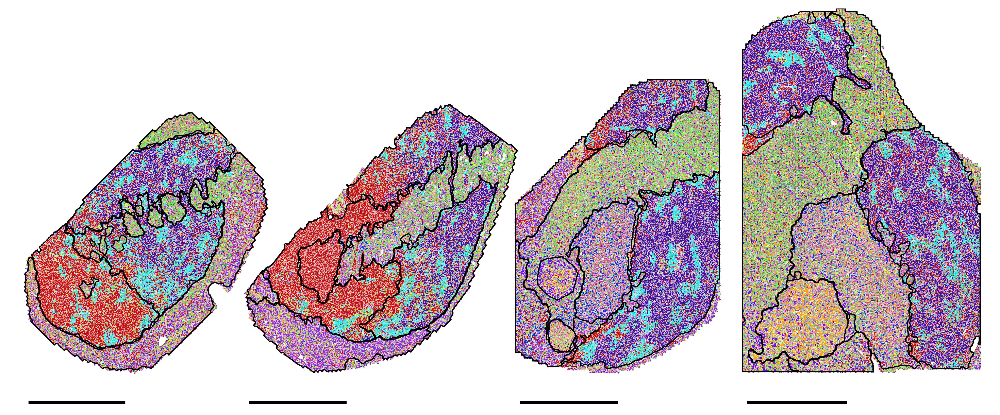

In [21]:
# define canvas for each samples, figure size will be based on the proprotion of the actual tissue size.

# fig,ax = plt.subplots(1,1,dpi = 300, figsize = (15,7))
import seaborn as sns
import matplotlib.patches as patches
import os
import copy 
rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 
reverse_coord = {'Donor_1311_posterior':False,'Donor_2724_anterior':True, 'Donor_2724_posterior':False,'Donor_3924_anterior':True }
invert_xaxis = {'Donor_1311_posterior':False,'Donor_2724_anterior':True,'Donor_2724_posterior':False,'Donor_3924_anterior':False }
invert_yaxis = {'Donor_1311_posterior':True,'Donor_2724_anterior':True,'Donor_2724_posterior':True,'Donor_3924_anterior':True}
backgd_sz = {'Donor_1311_posterior':0.002,'Donor_2724_anterior':0.002,'Donor_2724_posterior':0.002,'Donor_3924_anterior':0.002}
# spatial module dictionary
sptial_module_dict = {'Donor_1311_posterior':donor_1311_posterior_spatialModuleContours,'Donor_2724_anterior':donor_2427_anterior_spatialModuleContours,'Donor_2724_posterior':donor_2427_posterior_spatialModuleContours,'Donor_3924_anterior':donor_3924_anterior_spatialModuleContours}
Striosome_module_dict = {'Donor_1311_posterior':donor_1311_posterior_StriosomeContours,'Donor_2724_anterior':donor_2427_anterior_StriosomeContours,'Donor_2724_posterior':donor_2427_posterior_StriosomeContours,'Donor_3924_anterior':donor_3924_anterior_StriosomeContours}
# all_clusters_plot = ['GPin-BF Cholinergic GABA']
# all_clusters_plot = ['STRv D1 NUDAP MSN','STRd D2 StrioMat Hybrid MSN','STR D1D2 Hybrid MSN' ]
# all_clusters_plot = [x for x in all_clusters if 'gp' in x.lower()]
all_clusters_plot = ['STRd D2 Striosome MSN','STRv D2 MSN','STRd D2 Matrix MSN']
# all_clusters_plot = ['STRv D1 NUDAP MSN','STRd D2 StrioMat Hybrid MSN','STR D1D2 Hybrid MSN','STRd D1 Striosome MSN','STRv D1 MSN','STRd D1 Matrix MSN','STRd D2 Striosome MSN','STRv D2 MSN','STRd D2 Matrix MSN']
all_clusters_plot = copy.deepcopy(all_clusters)
# point_sz_map[all_clusters_plot[0]] = 2
# point_sz_map[all_clusters_plot[1]] = 2
# point_sz_map[all_clusters_plot[2]] = 2

fig = plt.figure(dpi = 300, figsize = (dx_max,dy_max))
bbox = fig.get_tightbbox()
ax = None

samples = ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']
# samples = ['Donor_2724_posterior','Donor_1311_posterior']
figure_title = 'All_celltypes_Grouplevel'
for i,sample in enumerate(samples):
    cond = adata_MERFISH.obs['samples'] == sample
    # adjucent the spatial coordinate 
    X_sample = adata_MERFISH[cond].obsm['X_spatial'].copy()
    X_sample = rotate(X_sample,rot_deg[sample])
    cnt = copy.deepcopy(sptial_module_dict[sample])
    strio_cnt = Striosome_module_dict[sample]['Striosome'].copy()
    
    for label_ in cnt:
        if isinstance(cnt[label_],list):
            for i in range(len(cnt[label_])):
                cnt[label_][i] = rotate(cnt[label_][i],rot_deg[sample])
        else:   
            cnt[label_] = rotate(cnt[label_],rot_deg[sample])
    for idx in range(len(strio_cnt)):
        strio_cnt[idx] = rotate(strio_cnt[idx],rot_deg[sample])

    if reverse_coord[sample]:
        X_sample = X_sample[:,::-1]
        for label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    cnt[label_][i] = cnt[label_][i][:,::-1]
            else:
                cnt[label_] = cnt[label_][:,::-1]
        for idx in range(len(strio_cnt)):
            strio_cnt[idx] = strio_cnt[idx][:,::-1]

    adata_MERFISH.obs.loc[cond,['x','y']] = X_sample.copy()
    # idenity the proprotion betwen the width and height of the sample
    dx,dy = np.abs(np.ptp(X_sample, axis = 0))
    if ax != None:
        bbox = ax.get_position()
    dx = dx/figsize_scale
    dy = dy/figsize_scale
    # calculate fraction of the new x and y size as fraction of the previous axis x and y size. we are doing this because, fig.add_axes accept values as fraction of the figure width and hight, 
    dx_frac = dx/fig.get_figwidth()
    dy_frac = dy/fig.get_figheight()
    width_gap = 1
    if i < 2:
        width_gap = 0.8
    #     point_sz_map[all_clusters_plot[0]] = 1
    #     point_sz_map[all_clusters_plot[1]] = 1
        # point_sz_map[all_clusters_plot[2]] = 1
    elif i < 3:
        width_gap = 0.9

    ax = fig.add_axes([bbox.xmin + width_gap*bbox.width,bbox.ymin,dx_frac, dy_frac], adjustable = 'box')
    plot_cluster_scdata(adata_MERFISH[cond],cluster_cmap,all_clusters = all_clusters_plot,clusters = all_clusters_plot,bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map, transpose=1,flipx=1,flipy=1,hue_input = 'Group_name' , ax = ax,use_seaborn = True,show_title = False )

    # add the outregion outlines 
    for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus','whitematter(Olfactory area)','IsCj']:
        if label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    ax.plot(cnt[label_][i][:,0],cnt[label_][i][:,1], lw = 1, c = 'k')
            else:
                ax.plot(cnt[label_][:,0],cnt[label_][:,1], lw = 1, c = 'k')
                
    # add the striosome contour outline
    # for cnt in strio_cnt:
    #     ax.scatter(cnt[:,0],cnt[:,1], s = 0.01, c = 'k')      

    # Set the axis limits 
    xmax, ymax = X_sample.max(axis=0)
    xmin, ymin = X_sample.min(axis=0)
    # ax.set_xlim([xmin,xmax])
    ax.set_ylim([ymin,ymax + 3500])
     # add scale bar
    if sample == 'Donor_2724_anterior':
        scalebar = patches.Rectangle([xmax - 500,1*ymax + 3000],-10000,200,color = 'k')
    else:    
        scalebar = patches.Rectangle([xmin + 500,1*ymax + 3000],10000,200,color = 'k')
    
    ax.add_patch(scalebar)

    if invert_xaxis[sample]:
        ax.invert_xaxis()
    
    if invert_yaxis[sample]:
        ax.invert_yaxis()
    # ax.set_aspect('equal', adjustable ='datalim')
    # if i == 0:
    #     # ax.text(xmin + 0.7*np.ptp(X_sample[:,0]), ymin - 0.2*np.ptp(X_sample[:,1]), f'{cluster_}', fontsize = 25)
    #     ax.text(xmin + 0.2*np.ptp(X_sample[:,0]), ymin - 0.2*np.ptp(X_sample[:,1]), f'{figure_title}', fontsize = 25)

plt.savefig(r'./figures/Figure3/supplemental/Combined_spatial_maps' + os.sep + figure_title + '.png',bbox_inches = 'tight')
plt.savefig(r'./figures/Figure3/supplemental/Combined_spatial_maps' + os.sep + figure_title + '.tif',bbox_inches = 'tight')

plt.show()

In [22]:
len(all_clusters)

60

-  GP- cell types

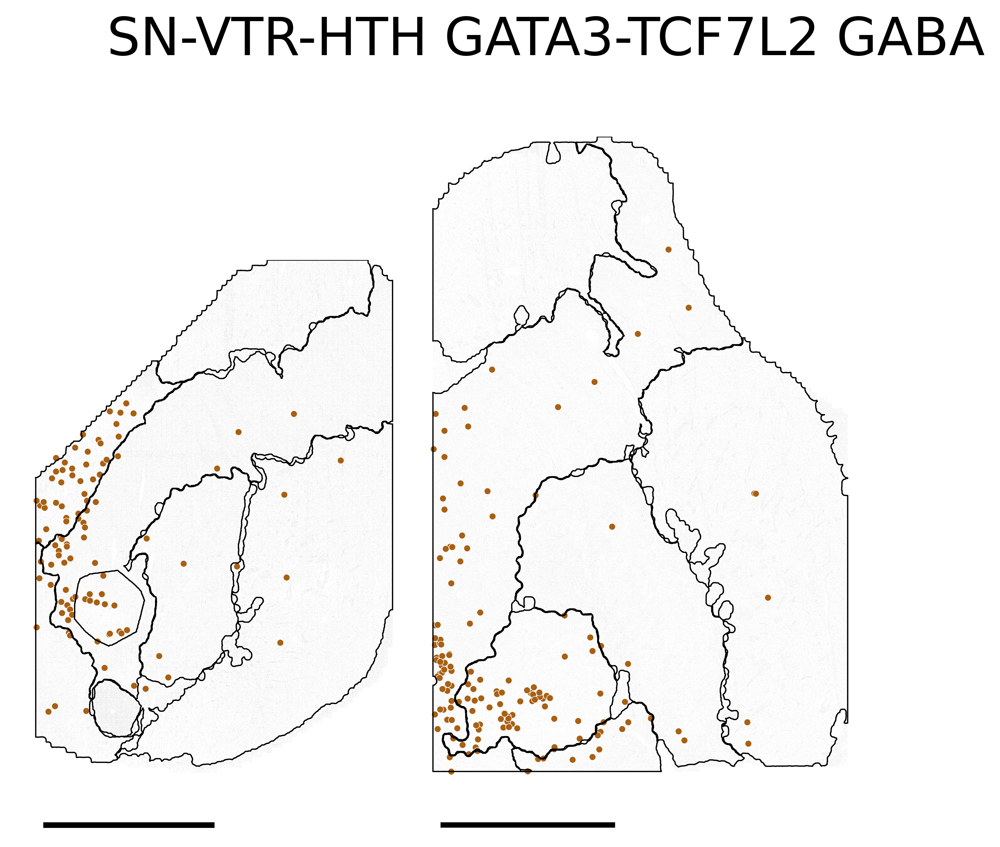

In [19]:
# define canvas for each samples, figure size will be based on the proprotion of the actual tissue size.

# fig,ax = plt.subplots(1,1,dpi = 300, figsize = (15,7))
import seaborn as sns
import matplotlib.patches as patches
import os
import copy 

rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 
reverse_coord = {'Donor_1311_posterior':False,'Donor_2724_anterior':True, 'Donor_2724_posterior':False,'Donor_3924_anterior':True }
invert_xaxis = {'Donor_1311_posterior':False,'Donor_2724_anterior':True,'Donor_2724_posterior':False,'Donor_3924_anterior':False }
invert_yaxis = {'Donor_1311_posterior':True,'Donor_2724_anterior':True,'Donor_2724_posterior':True,'Donor_3924_anterior':True}
backgd_sz = {'Donor_1311_posterior':0.002,'Donor_2724_anterior':0.002,'Donor_2724_posterior':0.002,'Donor_3924_anterior':0.002}
# spatial module dictionary
sptial_module_dict = {'Donor_1311_posterior':donor_1311_posterior_spatialModuleContours,'Donor_2724_anterior':donor_2427_anterior_spatialModuleContours,'Donor_2724_posterior':donor_2427_posterior_spatialModuleContours,'Donor_3924_anterior':donor_3924_anterior_spatialModuleContours}
Striosome_module_dict = {'Donor_1311_posterior':donor_1311_posterior_StriosomeContours,'Donor_2724_anterior':donor_2427_anterior_StriosomeContours,'Donor_2724_posterior':donor_2427_posterior_StriosomeContours,'Donor_3924_anterior':donor_3924_anterior_StriosomeContours}

# all_clusters_plot = ['GPe-NDB-SI LHX6-LHX8-GBX1 GABA', 'SN-VTR-HTH GATA3-TCF7L2 GABA','STR FS PTHLH-PVALB GABA', 'STR-BF TAC3-PLPP4-LHX8 GABA','STRd D2 StrioMat Hybrid MSN']
# all_clusters_plot = [ 'STRd D2 Striosome MSN','STRd D2 Matrix MSN','STRv D2 MSN']
all_clusters_plot = ['SN-VTR-HTH GATA3-TCF7L2 GABA']
point_sz_map['SN-VTR-HTH GATA3-TCF7L2 GABA'] = 10
for cluster_ in all_clusters_plot:

    fig = plt.figure(dpi = 300, figsize = (dx_max,dy_max))
    bbox = fig.get_tightbbox()
    ax = None

    samples = ['Donor_2724_posterior','Donor_1311_posterior']
    # samples = ['Donor_2427_posterior','Donor_1311_posterior']
    figure_title = 'GPin_Cholin_posterior'
    for sampleIdx,sample in enumerate(samples):
        cond = adata_MERFISH.obs['samples'] == sample
        # adjucent the spatial coordinate 
        X_sample = adata_MERFISH[cond].obsm['X_spatial'].copy()
        X_sample = rotate(X_sample,rot_deg[sample])
        cnt = copy.deepcopy(sptial_module_dict[sample])
        strio_cnt = Striosome_module_dict[sample]['Striosome'].copy()
        
        for label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    cnt[label_][i] = rotate(cnt[label_][i],rot_deg[sample])
            else:   
                cnt[label_] = rotate(cnt[label_],rot_deg[sample])
        for idx in range(len(strio_cnt)):
            strio_cnt[idx] = rotate(strio_cnt[idx],rot_deg[sample])

        if reverse_coord[sample]:
            X_sample = X_sample[:,::-1]
            for label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        cnt[label_][i] = cnt[label_][i][:,::-1]
                else:
                    cnt[label_] = cnt[label_][:,::-1]
            for idx in range(len(strio_cnt)):
                strio_cnt[idx] = strio_cnt[idx][:,::-1]

        adata_MERFISH.obs.loc[cond,['x','y']] = X_sample.copy()
        # idenity the proprotion betwen the width and height of the sample
        dx,dy = np.abs(np.ptp(X_sample, axis = 0))
        if ax != None:
            bbox = ax.get_position()
        dx = dx/figsize_scale
        dy = dy/figsize_scale
        # calculate fraction of the new x and y size as fraction of the previous axis x and y size. we are doing this because, fig.add_axes accept values as fraction of the figure width and hight, 
        dx_frac = dx/fig.get_figwidth()
        dy_frac = dy/fig.get_figheight()
        width_gap = 1
        # if sampleIdx < 2:
        #     width_gap = 0.8
        # #     point_sz_map[all_clusters_plot[0]] = 1
        # #     point_sz_map[all_clusters_plot[1]] = 1
        #     # point_sz_map[all_clusters_plot[2]] = 1
        # elif sampleIdx < 3:
        #     width_gap = 0.9

        ax = fig.add_axes([bbox.xmin + width_gap*bbox.width,bbox.ymin,dx_frac, dy_frac], adjustable = 'box')
        plot_cluster_scdata(adata_MERFISH[cond],cluster_cmap,all_clusters = [cluster_],clusters = [cluster_],bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map, transpose=1,flipx=1,flipy=1,hue_input = 'Group_name' , ax = ax,use_seaborn = True,show_title = False )

        # add the outregion outlines 
        for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus','whitematter(Olfactory area)','IsCj']:
            if label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        ax.plot(cnt[label_][i][:,0],cnt[label_][i][:,1], lw = 0.6, c = 'k')
                else:
                    ax.plot(cnt[label_][:,0],cnt[label_][:,1], lw = 0.6, c = 'k')
        # add the striosome contour outline
        # for cnt in strio_cnt:
        #     ax.scatter(cnt[:,0],cnt[:,1], s = 0.01, c = 'k')      

        # Set the axis limits 
        xmax, ymax = X_sample.max(axis=0)
        xmin, ymin = X_sample.min(axis=0)
        # ax.set_xlim([xmin,xmax])
        ax.set_ylim([ymin,ymax + 3500])
        # add scale bar
        # add scale bar
        if sample == 'Donor_2724_anterior':
            scalebar = patches.Rectangle([xmax - 500,1*ymax + 3000],-10000,200,color = 'k')
        else:    
            scalebar = patches.Rectangle([xmin + 500,1*ymax + 3000],10000,200,color = 'k')
        
        ax.add_patch(scalebar)
        
        if invert_xaxis[sample]:
            ax.invert_xaxis()
        
        if invert_yaxis[sample]:
            ax.invert_yaxis()
        # ax.set_aspect('equal', adjustable ='datalim')
        if sampleIdx == 0:
            ax.text(xmin + 0.2*np.ptp(X_sample[:,0]), ymin - 0.4*np.ptp(X_sample[:,1]), f'{cluster_}', fontsize = 25, color = 'k')
        #     ax.text(xmin + 0.2*np.ptp(X_sample[:,0]), ymin - 0.2*np.ptp(X_sample[:,1]), f'{figure_title}', fontsize = 25)

    file_name = '_'.join([x for x in f'{cluster_}'.replace(' ','_').split('-') ]) + 'GP_supplemental'
    plt.savefig(r'./figures/Figure3/supplemental/individual_spatial_maps' + os.sep + file_name + '.png',bbox_inches = 'tight')
    plt.savefig(r'./figures/Figure3/supplemental/individual_spatial_maps' + os.sep + file_name + '.tif',bbox_inches = 'tight')
    plt.savefig(r'./figures/Figure3/supplemental/individual_spatial_maps' + os.sep + file_name + '.eps',bbox_inches = 'tight')

    plt.show()

### 2. Cell type proportion.

In [10]:
np.unique(adata_MERFISH.obs['Class_name'])

array(['Astro-Epen', 'CN CGE GABA', 'CN GABA-Glut', 'CN LGE GABA',
       'CN MGE GABA', 'Cx GABA', 'F M GABA', 'F M Glut', 'Immune',
       'M Dopa', 'OPC-Oligo', 'Vascular'], dtype=object)

A. MSN neurons proportion

In [11]:
np.unique(adata_MERFISH.obs['samples'])

array(['Donor_1311_posterior', 'Donor_2724_anterior',
       'Donor_2724_posterior', 'Donor_3924_anterior'], dtype=object)

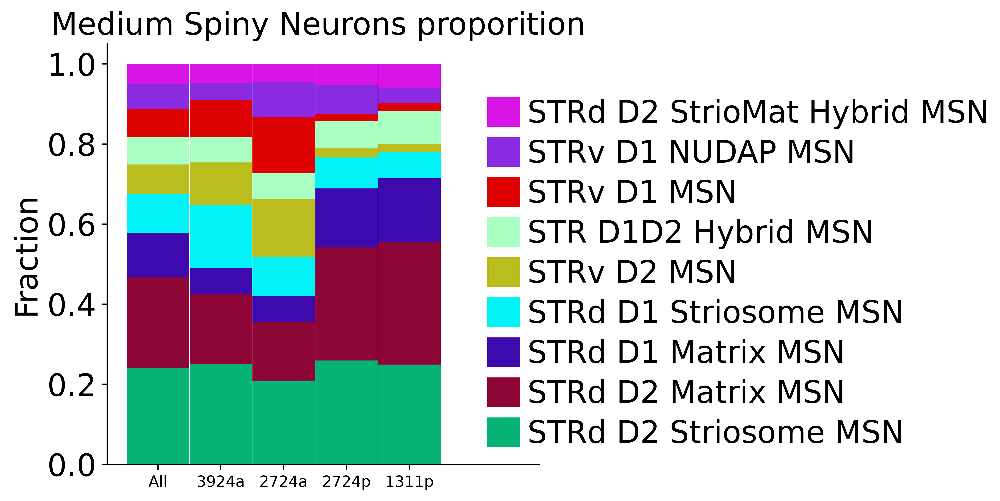

In [13]:
import matplotlib as mpl
mpl.rcParams['font.size'] = 20
# first get the overall proporition
adata_obs_MSN = adata_MERFISH.obs.copy()
MSN_subtypes = [nm for nm in np.unique(adata_obs_MSN['Subclass_name']) if 'msn' in nm.lower()]
adata_obs_MSN = adata_obs_MSN[adata_obs_MSN['Subclass_name'].isin(MSN_subtypes)].copy()

# # remove unused cell types,
celltype_cols = [nm for nm in adata_obs_MSN.columns if 'name' in nm.lower() ]
for nm in celltype_cols:
    adata_obs_MSN[nm] = adata_obs_MSN[nm].astype(str)
    adata_obs_MSN[nm] = adata_obs_MSN[nm].astype('category')
MSNType_fraction = [adata_obs_MSN['Group_name'].value_counts(normalize = True).to_frame().rename(columns = {'Group_name':'All'})]

# then get the per sample proporition 
for sample in ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']: #np.unique(adata_MERFISH.obs['samples']):

    adata_obs_MSN = adata_MERFISH[adata_MERFISH.obs['samples'] == sample].obs.copy()
    MSN_subtypes = [nm for nm in np.unique(adata_obs_MSN['Subclass_name']) if 'msn' in nm.lower()]
    adata_obs_MSN = adata_obs_MSN[adata_obs_MSN['Subclass_name'].isin(MSN_subtypes)].copy()

    # # remove unused cell types,
    celltype_cols = [nm for nm in adata_obs_MSN.columns if 'name' in nm.lower() ]
    for nm in celltype_cols:
        adata_obs_MSN[nm] = adata_obs_MSN[nm].astype(str)
        adata_obs_MSN[nm] = adata_obs_MSN[nm].astype('category')
    MSNType_fraction += [adata_obs_MSN['Group_name'].value_counts(normalize = True).to_frame().rename(columns = {'Group_name':sample})]

MSNType_fraction = pd.concat(MSNType_fraction,axis = 1)

# stacked bar plot
import matplotlib.patches as patches
import os
fig,ax = plt.subplots(1,1, figsize = (5,5), dpi = 300)
bottom = np.zeros(MSNType_fraction.shape[-1])
width = 0.99
xlabels = [MSNType_fraction.columns[0]] + [x.split('_')[1] + x.split('_')[2][0] for x in MSNType_fraction.columns[1:]]

for idx,type_ in enumerate(MSNType_fraction.index):
    vals = MSNType_fraction.loc[type_,:].values
    ax.bar(xlabels,vals,width = width ,bottom = bottom, color =cluster_cmap[type_])
    bottom += vals

ax.grid(False)
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_xticks([])
ax.set_ylabel('Fraction', fontdict={'fontsize': 20})

ax.tick_params('y',which='major',labelsize = 20)
ax.tick_params('x',which='major',labelsize = 10)
# add legend 
bbox = ax.get_position()
for i,type_ in enumerate(MSNType_fraction.index):
    rec = patches.Rectangle([bbox.xmin +  6.5*bbox.width , 0.3*bbox.ymin + i* 0.1] , 0.5,0.07, color = cluster_cmap[type_], )
    ax.add_patch(rec)

    # add label 
    ax.text(bbox.xmin +  7.3*bbox.width , (0.3*bbox.ymin + i* 0.1) + 0.03,type_,va = 'center')

ax.set_title(f'Medium Spiny Neurons proporition ', fontdict={'fontsize': 20})
# plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'concatenated_stackedbarplot_MSN_subtype_proportion' + '.png',bbox_inches = 'tight')
# plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'concatenated_stackedbarplot_MSN_subtype_proportion' + '.tif',bbox_inches = 'tight')
plt.show()

In [15]:
MSNType_fraction.to_csv('./figures/Figure3/celltype_proportion_tables' + os.sep + 'table_of_concatenated_stackedbarplot_MSN_subtype_proportion.csv')


B. CN CGE GABA proportion 

/tmp/ipykernel_982889/981971225.py:60: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([np.round(100*y) for y in yticks])


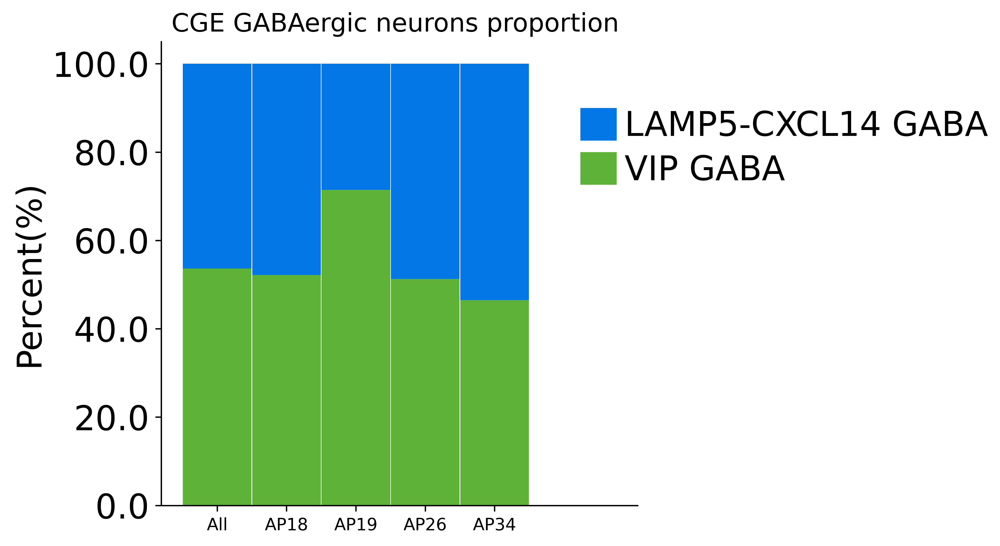

In [17]:
# first get the overall proporition
adata_obs_CGE = adata_MERFISH.obs.copy()
adata_obs_CGE = adata_obs_CGE[adata_obs_CGE['Class_name'].isin(['CN CGE GABA'])].copy()

# # remove unused cell types,
celltype_cols = [nm for nm in adata_obs_CGE.columns if 'name' in nm.lower() ]
for nm in celltype_cols:
    adata_obs_CGE[nm] = adata_obs_CGE[nm].astype(str)
    adata_obs_CGE[nm] = adata_obs_CGE[nm].astype('category')
CGEType_fraction = [adata_obs_CGE['Group_name'].value_counts(normalize = True).to_frame().rename(columns = {'Group_name':'All'})]

# then get the per sample proporition 
for sample in ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']: #np.unique(adata_MERFISH.obs['samples']):

    adata_obs_CGE = adata_MERFISH[adata_MERFISH.obs['samples'] == sample].obs.copy()
    adata_obs_CGE = adata_obs_CGE[adata_obs_CGE['Class_name'].isin(['CN CGE GABA'])].copy()

    # # remove unused cell types,
    celltype_cols = [nm for nm in adata_obs_CGE.columns if 'name' in nm.lower() ]
    for nm in celltype_cols:
        adata_obs_CGE[nm] = adata_obs_CGE[nm].astype(str)
        adata_obs_CGE[nm] = adata_obs_CGE[nm].astype('category')
    CGEType_fraction += [adata_obs_CGE['Group_name'].value_counts(normalize = True).to_frame().rename(columns = {'Group_name':sample})]

CGEType_fraction = pd.concat(CGEType_fraction,axis = 1)
# multiply by 100 to convert to percentage
# CGEType_fraction = CGEType_fraction * 100

# stacked bar plot
import matplotlib.patches as patches
import os
fig,ax = plt.subplots(1,1, figsize = (5,5), dpi = 300)
bottom = np.zeros(CGEType_fraction.shape[-1])
width = 0.99
xlabels = [CGEType_fraction.columns[0]] + [x.split('_')[1] + x.split('_')[2][0] for x in CGEType_fraction.columns[1:]]
xlabel_mapper = {'3924a':'AP18','2724a':'AP19','2724p':'AP26','1311p':'AP34'}
xlabels = xlabels[:1] + [xlabel_mapper[nm] for nm in xlabels[1:]]
for idx,type_ in enumerate(CGEType_fraction.index):
    vals = CGEType_fraction.loc[type_,:].values
    ax.bar(xlabels,vals,width = width ,bottom = bottom, color =cluster_cmap[type_])
    bottom += vals

ax.grid(False)
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_xticks([])
ax.set_ylabel('Percent(%)', fontdict={'fontsize': 20})

ax.tick_params('y',which='major',labelsize = 20)
ax.tick_params('x',which='major',labelsize = 10)
# add legend 
bbox = ax.get_position()
for i,type_ in enumerate(CGEType_fraction.index):
    rec = patches.Rectangle([bbox.xmin +  6.5*bbox.width , 0.8*bbox.ymax + i*0.1] , 0.5,0.07, color = cluster_cmap[type_], )
    ax.add_patch(rec)

    # add label 
    ax.text(bbox.xmin +  7.3*bbox.width , (0.8*bbox.ymax + i* 0.1) + 0.03,type_,va = 'center', fontsize = 20)
yticks = ax.get_yticks()
ax.set_yticklabels([np.round(100*y) for y in yticks])
ax.set_title(f'CGE GABAergic neurons proportion ', fontdict={'fontsize': 15})
plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'concatenated_stackedbarplot_CGE_subtype_proportion' + '.png',bbox_inches = 'tight')
plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'concatenated_stackedbarplot_CGE_subtype_proportion' + '.tif',bbox_inches = 'tight')
plt.show()

In [18]:
CGEType_fraction.to_csv('./figures/Figure3/celltype_proportion_tables' + os.sep + 'concatenated_stackedbarplot_CGE_subtype_proportion.csv')

C. CN MGE GABA proportion 

/tmp/ipykernel_982889/4167797262.py:58: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([np.round(100*y) for y in yticks])


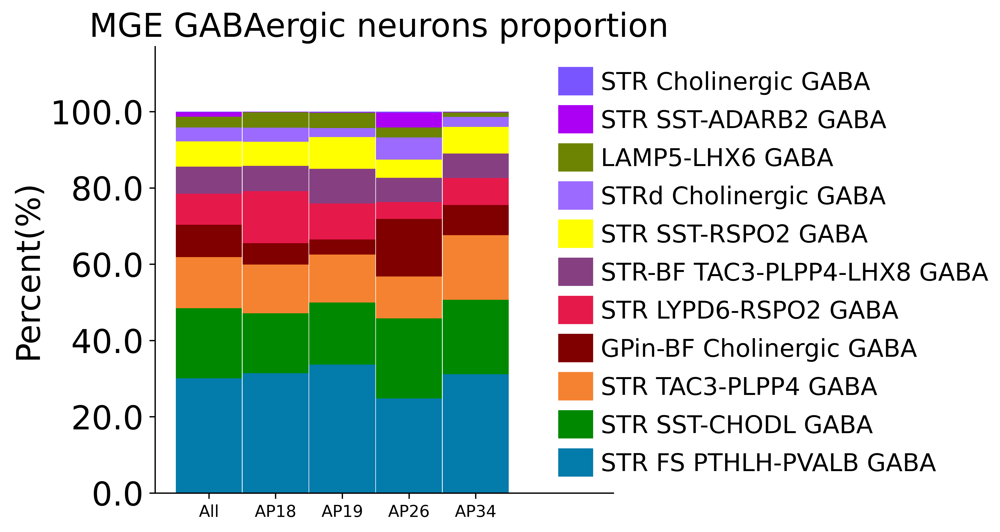

In [19]:
# first get the overall proporition
adata_obs_MGE = adata_MERFISH.obs.copy()
adata_obs_MGE = adata_obs_MGE[adata_obs_MGE['Class_name'].isin(['CN MGE GABA'])].copy()

# # remove unused cell types,
celltype_cols = [nm for nm in adata_obs_MGE.columns if 'name' in nm.lower() ]
for nm in celltype_cols:
    adata_obs_MGE[nm] = adata_obs_MGE[nm].astype(str)
    adata_obs_MGE[nm] = adata_obs_MGE[nm].astype('category')
MGEType_fraction = [adata_obs_MGE['Group_name'].value_counts(normalize = True).to_frame().rename(columns = {'Group_name':'All'})]

# then get the per sample proporition 
for sample in ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']: #np.unique(adata_MERFISH.obs['samples']):

    adata_obs_MGE = adata_MERFISH[adata_MERFISH.obs['samples'] == sample].obs.copy()
    adata_obs_MGE = adata_obs_MGE[adata_obs_MGE['Class_name'].isin(['CN MGE GABA'])].copy()

    # # remove unused cell types,
    celltype_cols = [nm for nm in adata_obs_MGE.columns if 'name' in nm.lower() ]
    for nm in celltype_cols:
        adata_obs_MGE[nm] = adata_obs_MGE[nm].astype(str)
        adata_obs_MGE[nm] = adata_obs_MGE[nm].astype('category')
    MGEType_fraction += [adata_obs_MGE['Group_name'].value_counts(normalize = True).to_frame().rename(columns = {'Group_name':sample})]

MGEType_fraction = pd.concat(MGEType_fraction,axis = 1)
# stacked bar plot
import matplotlib.patches as patches
import os
fig,ax = plt.subplots(1,1, figsize = (5,5), dpi = 300)
bottom = np.zeros(MGEType_fraction.shape[-1])
width = 0.99
xlabels = [MGEType_fraction.columns[0]] + [x.split('_')[1] + x.split('_')[2][0] for x in MGEType_fraction.columns[1:]]
xlabel_mapper = {'3924a':'AP18','2724a':'AP19','2724p':'AP26','1311p':'AP34'}
xlabels = xlabels[:1] + [xlabel_mapper[nm] for nm in xlabels[1:]]

for idx,type_ in enumerate(MGEType_fraction.index):
    vals = MGEType_fraction.loc[type_,:].values
    ax.bar(xlabels,vals,width = width ,bottom = bottom, color =cluster_cmap[type_])
    bottom += vals

ax.grid(False)
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_xticks([])
ax.set_ylabel('Percent(%)', fontdict={'fontsize': 20})

ax.tick_params('y',which='major',labelsize = 20)
ax.tick_params('x',which='major',labelsize = 10)
# add legend 
bbox = ax.get_position()
for i,type_ in enumerate(MGEType_fraction.index):
    rec = patches.Rectangle([bbox.xmin +  6.5*bbox.width , 0.3*bbox.ymin + i* 0.1] , 0.5,0.07, color = cluster_cmap[type_], )
    ax.add_patch(rec)

    # add label 
    ax.text(bbox.xmin +  7.3*bbox.width , (0.3*bbox.ymin + i* 0.1) + 0.03,type_,va = 'center', fontsize = 15)
yticks = ax.get_yticks()
ax.set_yticklabels([np.round(100*y) for y in yticks])
ax.set_title(f'MGE GABAergic neurons proportion ', fontdict={'fontsize': 20})
plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'concatenated_stackedbarplot_MGE_subtype_proportion' + '.png',bbox_inches = 'tight')
plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'concatenated_stackedbarplot_MGE_subtype_proportion' + '.tif',bbox_inches = 'tight')
plt.show()

In [20]:
MGEType_fraction.to_csv('./figures/Figure3/celltype_proportion_tables' + os.sep + 'concatenated_stackedbarplot_MGE_subtype_proportion.csv')

D. FM GABA and Glut

1. FM GABA

In [ ]:
# first get the overall proporition
adata_obs_FMGABA = adata_MERFISH.obs.copy()
adata_obs_FMGABA = adata_obs_FMGABA[adata_obs_FMGABA['Class_name'].isin(['F M GABA'])].copy()

# # remove unused cell types,
celltype_cols = [nm for nm in adata_obs_FMGABA.columns if 'name' in nm.lower() ]
for nm in celltype_cols:
    adata_obs_FMGABA[nm] = adata_obs_FMGABA[nm].astype(str)
    adata_obs_FMGABA[nm] = adata_obs_FMGABA[nm].astype('category')
FMGABAType_fraction = [adata_obs_FMGABA['Group_name'].value_counts(normalize = True).to_frame().rename(columns = {'Group_name':'All'})]

# then get the per sample proporition 
for sample in ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']: #np.unique(adata_MERFISH.obs['samples']):

    adata_obs_FMGABA = adata_MERFISH[adata_MERFISH.obs['samples'] == sample].obs.copy()
    adata_obs_FMGABA = adata_obs_FMGABA[adata_obs_FMGABA['Class_name'].isin(['F M GABA'])].copy()

    # # remove unused cell types,
    celltype_cols = [nm for nm in adata_obs_FMGABA.columns if 'name' in nm.lower() ]
    for nm in celltype_cols:
        adata_obs_FMGABA[nm] = adata_obs_FMGABA[nm].astype(str)
        adata_obs_FMGABA[nm] = adata_obs_FMGABA[nm].astype('category')
    FMGABAType_fraction += [adata_obs_FMGABA['Group_name'].value_counts(normalize = True).to_frame().rename(columns = {'Group_name':sample})]

FMGABAType_fraction = pd.concat(FMGABAType_fraction,axis = 1)
# stacked bar plot
import matplotlib.patches as patches
import os
fig,ax = plt.subplots(1,1, figsize = (5,5), dpi = 300)
bottom = np.zeros(FMGABAType_fraction.shape[-1])
width = 0.99
xlabels = [FMGABAType_fraction.columns[0]] + [x.split('_')[1] + x.split('_')[2][0] for x in FMGABAType_fraction.columns[1:]]
xlabel_mapper = {'3924a':'AP18','2724a':'AP19','2724p':'AP26','1311p':'AP34'}
xlabels = xlabels[:1] + [xlabel_mapper[nm] for nm in xlabels[1:]]
for idx,type_ in enumerate(FMGABAType_fraction.index):
    vals = FMGABAType_fraction.loc[type_,:].values
    ax.bar(xlabels,vals,width = width ,bottom = bottom, color =cluster_cmap[type_])
    bottom += vals

ax.grid(False)
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_xticks([])
ax.set_ylabel('Percent(%)', fontdict={'fontsize': 20})

ax.tick_params('y',which='major',labelsize = 20)
ax.tick_params('x',which='major',labelsize = 10)
# add legend 
bbox = ax.get_position()
for i,type_ in enumerate(FMGABAType_fraction.index):
    rec = patches.Rectangle([bbox.xmin +  6.5*bbox.width , 0.3*bbox.ymin + i* 0.1] , 0.5,0.07, color = cluster_cmap[type_], )
    ax.add_patch(rec)

    # add label 
    ax.text(bbox.xmin +  7.3*bbox.width , (0.3*bbox.ymin + i* 0.1) + 0.03,type_,va = 'center', fontsize = 15)
yticks = ax.get_yticks()
ax.set_yticklabels([np.round(100*y) for y in yticks])
ax.set_title(f'F M GABAergic neurons proportion ', fontdict={'fontsize': 20}, y = 1.05 )
plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'concatenated_stackedbarplot_FMGABA_subtype_proportion' + '.png',bbox_inches = 'tight')
plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'concatenated_stackedbarplot_FMGABA_subtype_proportion' + '.tif',bbox_inches = 'tight')
plt.show()

In [22]:
FMGABAType_fraction.to_csv('./figures/Figure3/celltype_proportion_tables' + os.sep + 'concatenated_stackedbarplot_FMGABA_subtype_proportion.csv')

2. FM-Glut

/tmp/ipykernel_982889/2965220212.py:57: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([np.round(100*y) for y in yticks])


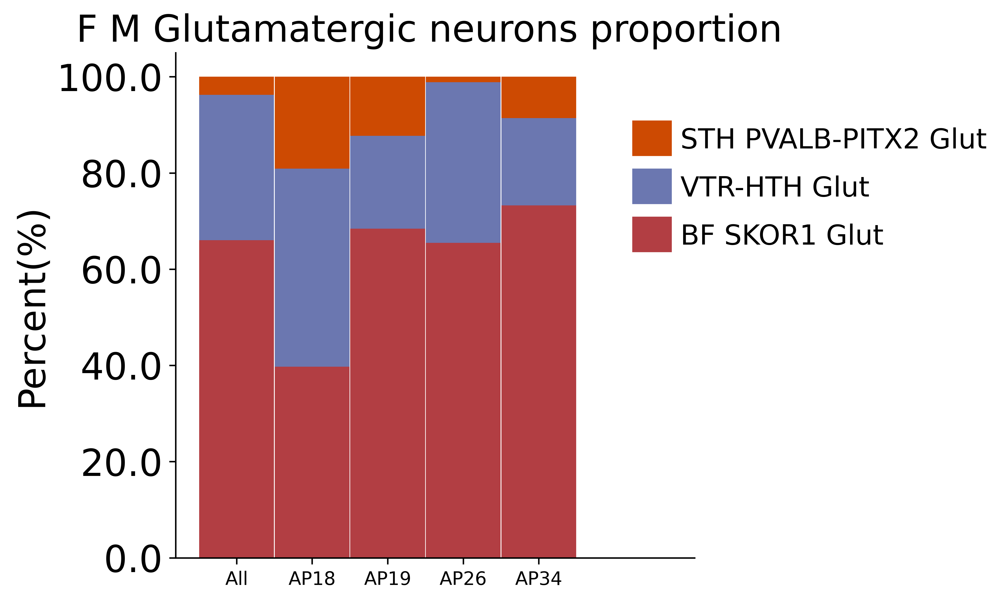

In [24]:
# first get the overall proporition
adata_obs_FMGLUT = adata_MERFISH.obs.copy()
adata_obs_FMGLUT = adata_obs_FMGLUT[adata_obs_FMGLUT['Class_name'].isin(['F M Glut'])].copy()

# # remove unused cell types,
celltype_cols = [nm for nm in adata_obs_FMGLUT.columns if 'name' in nm.lower() ]
for nm in celltype_cols:
    adata_obs_FMGLUT[nm] = adata_obs_FMGLUT[nm].astype(str)
    adata_obs_FMGLUT[nm] = adata_obs_FMGLUT[nm].astype('category')
FMGLUTType_fraction = [adata_obs_FMGLUT['Group_name'].value_counts(normalize = True).to_frame().rename(columns = {'Group_name':'All'})]

# then get the per sample proporition 
for sample in ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']: #np.unique(adata_MERFISH.obs['samples']):

    adata_obs_FMGLUT = adata_MERFISH[adata_MERFISH.obs['samples'] == sample].obs.copy()
    adata_obs_FMGLUT = adata_obs_FMGLUT[adata_obs_FMGLUT['Class_name'].isin(['F M Glut'])].copy()

    # # remove unused cell types,
    celltype_cols = [nm for nm in adata_obs_FMGLUT.columns if 'name' in nm.lower() ]
    for nm in celltype_cols:
        adata_obs_FMGLUT[nm] = adata_obs_FMGLUT[nm].astype(str)
        adata_obs_FMGLUT[nm] = adata_obs_FMGLUT[nm].astype('category')
    FMGLUTType_fraction += [adata_obs_FMGLUT['Group_name'].value_counts(normalize = True).to_frame().rename(columns = {'Group_name':sample})]

FMGLUTType_fraction = pd.concat(FMGLUTType_fraction,axis = 1)
# stacked bar plot
import matplotlib.patches as patches
import os
fig,ax = plt.subplots(1,1, figsize = (5,5), dpi = 300)
bottom = np.zeros(FMGLUTType_fraction.shape[-1])
width = 0.99
xlabels = [FMGLUTType_fraction.columns[0]] + [x.split('_')[1] + x.split('_')[2][0] for x in FMGLUTType_fraction.columns[1:]]
xlabel_mapper = {'3924a':'AP18','2724a':'AP19','2724p':'AP26','1311p':'AP34'}
xlabels = xlabels[:1] + [xlabel_mapper[nm] for nm in xlabels[1:]]
for idx,type_ in enumerate(FMGLUTType_fraction.index):
    vals = FMGLUTType_fraction.loc[type_,:].values
    ax.bar(xlabels,vals,width = width ,bottom = bottom, color =cluster_cmap[type_])
    bottom += vals

ax.grid(False)
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_xticks([])
ax.set_ylabel('Percent(%)', fontdict={'fontsize': 20})

ax.tick_params('y',which='major',labelsize = 20)
ax.tick_params('x',which='major',labelsize = 10)
# add legend 
bbox = ax.get_position()
for i,type_ in enumerate(FMGLUTType_fraction.index):
    rec = patches.Rectangle([bbox.xmin +  6.5*bbox.width , 0.7*bbox.ymax + i* 0.1] , 0.5,0.07, color = cluster_cmap[type_], )
    ax.add_patch(rec)

    # add label 
    ax.text(bbox.xmin +  7.3*bbox.width , (0.7*bbox.ymax + i* 0.1) + 0.03,type_,va = 'center', fontsize = 15)
yticks = ax.get_yticks()
ax.set_yticklabels([np.round(100*y) for y in yticks])
ax.set_title(f'F M Glutamatergic neurons proportion ', fontdict={'fontsize': 20})
plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'concatenated_stackedbarplot_FMGlut_subtype_proportion' + '.png',bbox_inches = 'tight')
plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'concatenated_stackedbarplot_FMGlut_subtype_proportion' + '.tif',bbox_inches = 'tight')
plt.show()

In [25]:
FMGLUTType_fraction.to_csv('./figures/Figure3/celltype_proportion_tables' + os.sep + 'concatenated_stackedbarplot_FMGlut_subtype_proportion.csv')

E. GP cell types

In [39]:
np.unique(adata_MERFISH.obs['samples'])

array(['Donor_1311_posterior', 'Donor_2427_anterior',
       'Donor_2427_posterior', 'Donor_3924_anterior'], dtype=object)

- GP cell types for each sample 

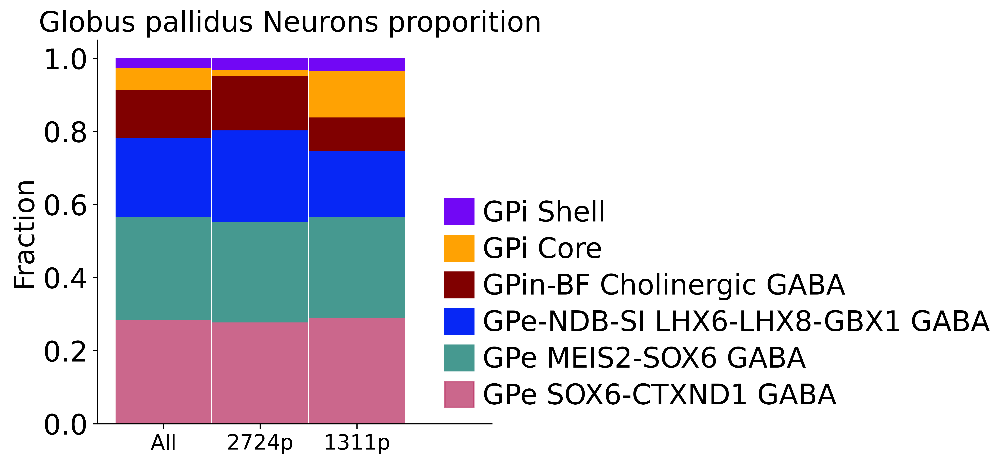

In [26]:
# first get the overall proporition
adata_obs_GP = adata_MERFISH.obs.copy()
GP_subtypes = [nm for nm in np.unique(adata_obs_GP['Group_name']) if 'gp' in nm.lower()]
adata_obs_GP = adata_obs_GP[adata_obs_GP['Group_name'].isin(GP_subtypes)].copy()

# # remove unused cell types,
celltype_cols = [nm for nm in adata_obs_GP.columns if 'name' in nm.lower() ]
for nm in celltype_cols:
    adata_obs_GP[nm] = adata_obs_GP[nm].astype(str)
    adata_obs_GP[nm] = adata_obs_GP[nm].astype('category')
GPType_fraction = [adata_obs_GP['Group_name'].value_counts(normalize = True).to_frame().rename(columns = {'Group_name':'All'})]

# then get the per sample proporition 
for sample in ['Donor_2724_posterior','Donor_1311_posterior']: #np.unique(adata_MERFISH.obs['samples']):

    adata_obs_GP = adata_MERFISH[adata_MERFISH.obs['samples'] == sample].obs.copy()
    GP_subtypes = [nm for nm in np.unique(adata_obs_GP['Group_name']) if 'gp' in nm.lower()]
    adata_obs_GP = adata_obs_GP[adata_obs_GP['Group_name'].isin(GP_subtypes)].copy()

    # # remove unused cell types,
    celltype_cols = [nm for nm in adata_obs_GP.columns if 'name' in nm.lower() ]
    for nm in celltype_cols:
        adata_obs_GP[nm] = adata_obs_GP[nm].astype(str)
        adata_obs_GP[nm] = adata_obs_GP[nm].astype('category')
    GPType_fraction += [adata_obs_GP['Group_name'].value_counts(normalize = True).to_frame().rename(columns = {'Group_name':sample})]


GPType_fraction = pd.concat(GPType_fraction,axis = 1)

# stacked bar plot
import matplotlib.patches as patches
import os
fig,ax = plt.subplots(1,1, figsize = (5,5), dpi = 300)
bottom = np.zeros(GPType_fraction.shape[-1])
width = 0.99
xlabels = [GPType_fraction.columns[0]] + [x.split('_')[1] + x.split('_')[2][0] for x in GPType_fraction.columns[1:]]

for idx,type_ in enumerate(GPType_fraction.index):
    vals = GPType_fraction.loc[type_,:].values
    ax.bar(xlabels,vals,width = width ,bottom = bottom, color =cluster_cmap[type_])
    bottom += vals

ax.grid(False)
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_xticks([])
ax.set_ylabel('Fraction', fontdict={'fontsize': 20})

ax.tick_params('y',which='major',labelsize = 20)
ax.tick_params('x',which='major',labelsize = 15)

# add legend 
bbox = ax.get_position()
for i,type_ in enumerate(GPType_fraction.index):
    rec = patches.Rectangle([bbox.xmin +  3.5*bbox.width , 0.3*bbox.ymin + i* 0.1] , 0.3,0.07, color = cluster_cmap[type_], )
    ax.add_patch(rec)

    # add label 
    ax.text(bbox.xmin +  4.*bbox.width , (0.3*bbox.ymin + i* 0.1) + 0.03,type_,va = 'center')

ax.set_title(f'Globus pallidus Neurons proporition ', fontdict={'fontsize': 20})
plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'concatenated_stackedbarplot_GP_subtype_proportion' + '.png',bbox_inches = 'tight')
plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'concatenated_stackedbarplot_GP_subtype_proportion' + '.tif',bbox_inches = 'tight')
plt.show()

In [27]:
GPType_fraction.to_csv('./figures/Figure3/celltype_proportion_tables' + os.sep + 'concatenated_stackedbarplot_GP_subtype_proportion.csv')

F. Proportion in major cell types

In [96]:
np.unique(adata_MERFISH.obs['Class_name'])

array(['Astro-Epen', 'CN CGE GABA', 'CN GABA-Glut', 'CN LGE GABA',
       'CN MGE GABA', 'Cx GABA', 'F M GABA', 'F M Glut', 'Immune',
       'M Dopa', 'OPC-Oligo', 'Vascular'], dtype=object)

In [28]:
class_map = {'Astro-Epen': "#E69F00",
 'CN CGE GABA': "#dc08f3",
 'CN LGE GABA': "#D55E00",
 'CN MGE GABA': "#56B4E9",
 'Cx GABA': '#469990',
 'F M GABA': '#000075',
 'F M Glut': "#ffe600",
 'Immune': "#1227E1",
 'OPC-Oligo': "#009E73",
 'Vascular': "#CC79A7",
 'M Dopa': "#FF008C",
 'CN GABA-Glut': "#13FD07"}

In [29]:
class_map.update({'Astro-Epen': "#bfef45",
 'CN CGE GABA': "#dc08f3",
 'CN LGE GABA': "#D55E00",
 'CN MGE GABA': "#56B4E9",
 'Cx GABA': '#02FFE1',
 'F M GABA': '#000075',
 'F M Glut': '#fabed4',
 'Immune': "#1227E1",
 'OPC-Oligo': "#01AC7F",
 'Vascular': "#CC79A7"})

- proporition of non MSN neuron 

In [31]:
np.unique(adata_MERFISH.obs['samples'])

array(['Donor_1311_posterior', 'Donor_2427_anterior',
       'Donor_2427_posterior', 'Donor_3924_anterior'], dtype=object)

- per sample proporition

- All Major cell types 

In [ ]:
# first get the overall proporition
adata_obs = adata_MERFISH.obs.copy()

# # remove unused cell types,
celltype_cols = [nm for nm in adata_obs.columns if 'name' in nm.lower() ]
for nm in celltype_cols:
    adata_obs[nm] = adata_obs[nm].astype(str)
    adata_obs[nm] = adata_obs[nm].astype('category')
nonMSNType_fraction = [adata_obs['Class_name'].value_counts(normalize = True).to_frame().rename(columns = {'Class_name':'All'})]

# then get the per sample proporition 
for sample in ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']: #np.unique(adata_MERFISH.obs['samples']):

    adata_obs = adata_MERFISH[adata_MERFISH.obs['samples'] == sample].obs.copy()

    # # remove unused cell types,
    celltype_cols = [nm for nm in adata_obs.columns if 'name' in nm.lower() ]
    for nm in celltype_cols:
        adata_obs[nm] = adata_obs[nm].astype(str)
        adata_obs[nm] = adata_obs[nm].astype('category')
    nonMSNType_fraction += [adata_obs['Class_name'].value_counts(normalize = True).to_frame().rename(columns = {'Class_name':sample})]

nonMSNType_fraction = pd.concat(nonMSNType_fraction,axis = 1)

# stacked bar plot
import matplotlib.patches as patches
import os
fig,ax = plt.subplots(1,1, figsize = (5,5), dpi = 300)
bottom = np.zeros(nonMSNType_fraction.shape[-1])
width = 0.99
xlabels = [nonMSNType_fraction.columns[0]] + [x.split('_')[1] + x.split('_')[2][0] for x in nonMSNType_fraction.columns[1:]]

for idx,type_ in enumerate(nonMSNType_fraction.index):
    vals = nonMSNType_fraction.loc[type_,:].values
    ax.bar(xlabels,vals,width = width ,bottom = bottom, color =class_map[type_])
    bottom += vals

ax.grid(False)
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_xticks([])
ax.set_ylabel('Fraction', fontdict={'fontsize': 20})

ax.tick_params('y',which='major',labelsize = 20)
ax.tick_params('x',which='major',labelsize = 10)
# add legend 
bbox = ax.get_position()
for i,type_ in enumerate(nonMSNType_fraction.index):
    rec = patches.Rectangle([bbox.xmin +  6.5*bbox.width , 0.3*bbox.ymin + i* 0.1] , 0.5,0.07, color = class_map[type_], )
    ax.add_patch(rec)

    # add label 
    ax.text(bbox.xmin +  7.3*bbox.width , (0.3*bbox.ymin + i* 0.1) + 0.03,type_,va = 'center')

ax.set_title(f'Major classes ', fontdict={'fontsize': 20})
plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'concatenated_stackedbarplot_MajorClass_proportion' + '.png',bbox_inches = 'tight')
plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'concatenated_stackedbarplot_MajorClass_proportion' + '.tif',bbox_inches = 'tight')
plt.show()

In [31]:
nonMSNType_fraction.to_csv('./figures/Figure3/celltype_proportion_tables' + os.sep + 'concatenated_stackedbarplot_MajorClass_proportion.csv')

G. Non-MSN neurons - concatenated plot

In [ ]:
# first get the overall proporition
adata_obs = adata_MERFISH.obs.copy()
keepNeuron = adata_obs['Neighborhood_name'].isin(['Nonneuron'])
adata_obs = adata_obs[~keepNeuron].copy()
Major_celltype = [nm for nm in np.unique(adata_obs['Class_name']) if nm != 'CN LGE GABA']
adata_obs = adata_obs[adata_obs['Class_name'].isin(Major_celltype)].copy()

# # remove unused cell types,
celltype_cols = [nm for nm in adata_obs.columns if 'name' in nm.lower() ]
for nm in celltype_cols:
    adata_obs[nm] = adata_obs[nm].astype(str)
    adata_obs[nm] = adata_obs[nm].astype('category')
nonMSNType_fraction = [adata_obs['Class_name'].value_counts(normalize = True).to_frame().rename(columns = {'Class_name':'All'})]

# then get the per sample proporition 
for sample in ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']: #np.unique(adata_MERFISH.obs['samples']):

    adata_obs = adata_MERFISH[adata_MERFISH.obs['samples'] == sample].obs.copy()
    keepNeuron = adata_obs['Neighborhood_name'].isin(['Nonneuron'])
    adata_obs = adata_obs[~keepNeuron].copy()
    Major_celltype = [nm for nm in np.unique(adata_obs['Class_name']) if nm != 'CN LGE GABA']
    adata_obs = adata_obs[adata_obs['Class_name'].isin(Major_celltype)].copy()

    # # remove unused cell types,
    celltype_cols = [nm for nm in adata_obs.columns if 'name' in nm.lower() ]
    for nm in celltype_cols:
        adata_obs[nm] = adata_obs[nm].astype(str)
        adata_obs[nm] = adata_obs[nm].astype('category')
    nonMSNType_fraction += [adata_obs['Class_name'].value_counts(normalize = True).to_frame().rename(columns = {'Class_name':sample})]

nonMSNType_fraction = pd.concat(nonMSNType_fraction,axis = 1)
# nonMSNType_fraction = 100*nonMSNType_fraction
# stacked bar plot
import matplotlib.patches as patches
import os
fig,ax = plt.subplots(1,1, figsize = (5,5), dpi = 300)
bottom = np.zeros(nonMSNType_fraction.shape[-1])
width = 0.99
xlabels = [nonMSNType_fraction.columns[0]] + [x.split('_')[1] + x.split('_')[2][0] for x in nonMSNType_fraction.columns[1:]]
xlabel_mapper = {'3924a':'AP18','2724a':'AP19','2724p':'AP26','1311p':'AP34'}
xlabels = xlabels[:1] + [xlabel_mapper[nm] for nm in xlabels[1:]]
for idx,type_ in enumerate(nonMSNType_fraction.index):
    vals = nonMSNType_fraction.loc[type_,:].values
    ax.bar(xlabels,vals,width = width ,bottom = bottom, color =class_map[type_])
    bottom += vals

ax.grid(False)
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_xticks([])
ax.set_ylabel('Percent(%)', fontdict={'fontsize': 20})

ax.tick_params('y',which='major',labelsize = 20)
ax.tick_params('x',which='major',labelsize = 10)
# add legend 
bbox = ax.get_position()
for i,type_ in enumerate(nonMSNType_fraction.index):
    rec = patches.Rectangle([bbox.xmin +  6.5*bbox.width , 0.3*bbox.ymin + i* 0.1] , 0.5,0.07, color = class_map[type_], )
    ax.add_patch(rec)

    # add label 
    ax.text(bbox.xmin +  7.3*bbox.width , (0.3*bbox.ymin + i* 0.1) + 0.03,type_,va = 'center', fontsize = 15)
yticks = ax.get_yticks()
ax.set_yticklabels([np.round(100*y) for y in yticks])
ax.set_title(f'Non-MSN/GP neurons proportion ', fontdict={'fontsize': 20})
plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'concatenated_stackedbarplot_MajorNonMSN_neuronCellType_proportion' + '.png',bbox_inches = 'tight')
plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'concatenated_stackedbarplot_MajorNonMSN_neuronCellType_proportion' + '.tif',bbox_inches = 'tight')
plt.show()

In [42]:
nonMSNType_fraction.to_csv(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + 'concatenated_stackedbarplot_MajorNonMSN_neuronCellType_proportion.csv')

H.  Proportion of major neuronal populations. 

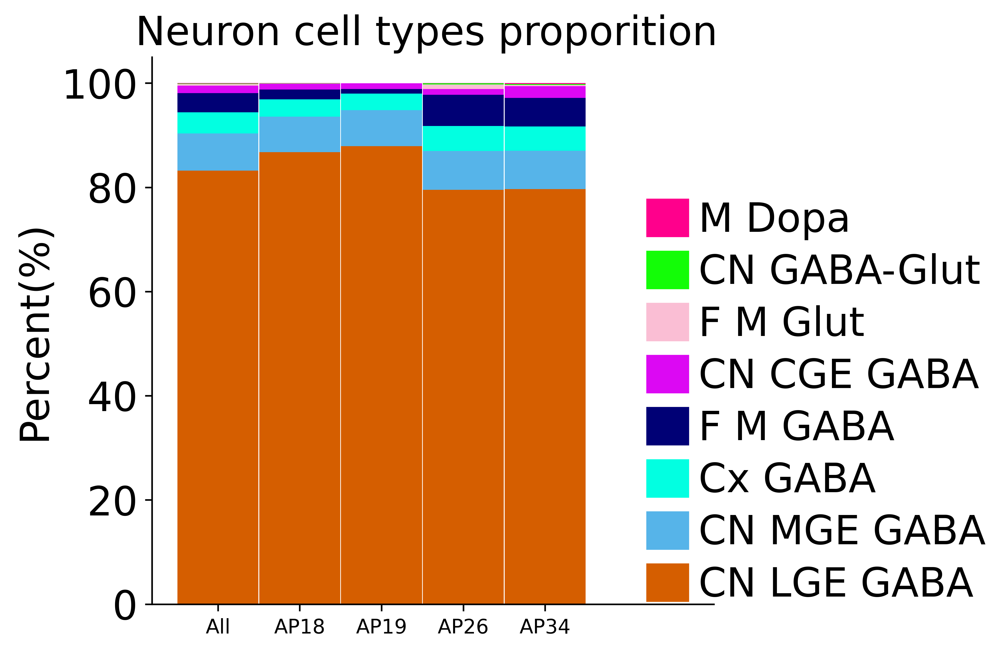

In [39]:
# first get the overall proporition
import matplotlib as mpl
mpl.rcParams['font.size'] = 20
adata_obs = adata_MERFISH.obs.copy()
keepNeuron = ~(adata_obs['Neighborhood_name'].isin(['Nonneuron']))
adata_obs = adata_obs[keepNeuron].copy()

# # remove unused cell types,
celltype_cols = [nm for nm in adata_obs.columns if 'name' in nm.lower() ]
for nm in celltype_cols:
    adata_obs[nm] = adata_obs[nm].astype(str)
    adata_obs[nm] = adata_obs[nm].astype('category')
Neuron_fraction = [adata_obs['Class_name'].value_counts(normalize = True).to_frame().rename(columns = {'Class_name':'All'})]

# then get the per sample proporition 
for sample in ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']: #np.unique(adata_MERFISH.obs['samples']):

    adata_obs = adata_MERFISH[adata_MERFISH.obs['samples'] == sample].obs.copy()
    keepNeuron = ~(adata_obs['Neighborhood_name'].isin(['Nonneuron']))
    adata_obs = adata_obs[keepNeuron].copy()
    
    # # remove unused cell types,
    celltype_cols = [nm for nm in adata_obs.columns if 'name' in nm.lower() ]
    for nm in celltype_cols:
        adata_obs[nm] = adata_obs[nm].astype(str)
        adata_obs[nm] = adata_obs[nm].astype('category')
    Neuron_fraction += [adata_obs['Class_name'].value_counts(normalize = True).to_frame().rename(columns = {'Class_name':sample})]

Neuron_fraction = pd.concat(Neuron_fraction,axis = 1)
Neuron_fraction = 100*Neuron_fraction

# stacked bar plot
import matplotlib.patches as patches
import os
fig,ax = plt.subplots(1,1, figsize = (5,5), dpi = 300)
bottom = np.zeros(Neuron_fraction.shape[-1])
width = 0.99
xlabels = [Neuron_fraction.columns[0]] + [x.split('_')[1] + x.split('_')[2][0] for x in Neuron_fraction.columns[1:]]
xlabel_mapper = {'3924a':'AP18','2724a':'AP19','2724p':'AP26','1311p':'AP34'}
xlabels = xlabels[:1] + [xlabel_mapper[nm] for nm in xlabels[1:]]

for idx,type_ in enumerate(Neuron_fraction.index):
    vals = Neuron_fraction.loc[type_,:].values
    ax.bar(xlabels,vals,width = width ,bottom = bottom, color =class_map[type_])
    bottom += vals

ax.grid(False)
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_xticks([])
ax.set_ylabel('Percent(%)', fontdict={'fontsize': 20})

ax.tick_params('y',which='major',labelsize = 20)
ax.tick_params('x',which='major',labelsize = 10)
# add legend 
bbox = ax.get_position()
for i,type_ in enumerate(Neuron_fraction.index):
    rec = patches.Rectangle([bbox.xmin +  6.5*bbox.width , 0.7*bbox.ymax + i* 10] , 0.5,7, color = class_map[type_], )
    ax.add_patch(rec)

    # add label 
    ax.text(bbox.xmin +  7.3*bbox.width , (0.7*bbox.ymax + i* 10) + 3,type_,va = 'center')

ax.set_title(f'Neuron cell types proporition ', fontdict={'fontsize': 20})
plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'concatenated_stackedbarplot_MajorNeuron_CellType_proportion' + '.png',bbox_inches = 'tight')
plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'concatenated_stackedbarplot_MajorNeuron_CellType_proportion' + '.tif',bbox_inches = 'tight')
plt.show()

In [37]:
Neuron_fraction.to_csv('./figures/Figure3/celltype_proportion_tables' + os.sep + 'concatenated_stackedbarplot_MajorNeuron_CellType_proportion.csv')

I.  Proportion of MGE + CGE interneurons in the Striatium (Pu, Ca, NAC)

In [13]:
CGEMGEType_fraction

,proportion,proportion,proportion,proportion,proportion
Group_name,,,,,
STR FS PTHLH-PVALB GABA,0.347941,0.394629,0.399385,0.324315,0.296073
STR SST-CHODL GABA,0.180166,0.157032,0.168886,0.201749,0.186175
STR TAC3-PLPP4 GABA,0.159422,0.176832,0.153520,0.147311,0.164095
GPin-BF Cholinergic GABA,0.062114,0.037324,0.046393,0.116958,0.047547
STR-BF TAC3-PLPP4-LHX8 GABA,0.060451,0.077151,0.090004,0.045035,0.037636
VIP GABA,0.055978,0.040282,0.041124,0.035137,0.093213
STRd Cholinergic GABA,0.038203,0.038462,0.027514,0.069119,0.023711
LAMP5-CXCL14 GABA,0.036461,0.027310,0.015220,0.017816,0.073893
STR LYPD6-RSPO2 GABA,0.025495,0.030041,0.018440,0.019795,0.033371


In [ ]:
import matplotlib as mpl
mpl.rcParams['font.size'] = 20
# first get the overall proporition

adata_obs = adata_MERFISH.obs.copy()
keep_MGECGE = adata_obs['Class_name'].isin(['CN MGE GABA','CN CGE GABA'])
keep_Striatium = adata_obs['Final_Major_region_label'].isin(['Caudate','Putamen','NAC_shell','NAC_core'])
adata_obs = adata_obs[keep_MGECGE & keep_Striatium]
# # remove unused cell types,
celltype_cols = [nm for nm in adata_obs.columns if 'name' in nm.lower() ]
for nm in celltype_cols:
    adata_obs[nm] = adata_obs[nm].astype(str)
    adata_obs[nm] = adata_obs[nm].astype('category')
CGEMGEType_fraction = [adata_obs['Group_name'].value_counts(normalize = True).to_frame().rename(columns = {'proportion':'All'})]

# then get the per sample proporition 
for sample in ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']: #np.unique(adata_MERFISH.obs['samples']):

    adata_obs = adata_MERFISH[adata_MERFISH.obs['samples'] == sample].obs.copy()
    keep_MGECGE = adata_obs['Class_name'].isin(['CN MGE GABA','CN CGE GABA'])
    keep_Striatium = adata_obs['Final_Major_region_label'].isin(['Caudate','Putamen','NAC_shell','NAC_core'])
    adata_obs = adata_obs[keep_MGECGE & keep_Striatium]


    # # remove unused cell types,
    celltype_cols = [nm for nm in adata_obs.columns if 'name' in nm.lower() ]
    for nm in celltype_cols:
        adata_obs[nm] = adata_obs[nm].astype(str)
        adata_obs[nm] = adata_obs[nm].astype('category')
    CGEMGEType_fraction += [adata_obs['Group_name'].value_counts(normalize = True).to_frame().rename(columns = {'proportion':sample})]

CGEMGEType_fraction = pd.concat(CGEMGEType_fraction,axis = 1)

# stacked bar plot
import matplotlib.patches as patches
import os
fig,ax = plt.subplots(1,1, figsize = (5,5), dpi = 300)
bottom = np.zeros(CGEMGEType_fraction.shape[-1])
width = 0.99
xlabels = [CGEMGEType_fraction.columns[0]] + [x.split('_')[1] + x.split('_')[2][0] for x in CGEMGEType_fraction.columns[1:]]

for idx,type_ in enumerate(CGEMGEType_fraction.index):
    vals = CGEMGEType_fraction.loc[type_,:].values
    ax.bar(xlabels,vals,width = width ,bottom = bottom, color =cluster_cmap[type_])
    bottom += vals

ax.grid(False)
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_xticks([])
ax.set_ylabel('Fraction', fontdict={'fontsize': 20})

ax.tick_params('y',which='major',labelsize = 20)
ax.tick_params('x',which='major',labelsize = 10)
# add legend 
bbox = ax.get_position()
for i,type_ in enumerate(CGEMGEType_fraction.index):
    rec = patches.Rectangle([bbox.xmin +  6.5*bbox.width , 0.3*bbox.ymin + i* 0.1] , 0.5,0.07, color = cluster_cmap[type_], )
    ax.add_patch(rec)

    # add label 
    ax.text(bbox.xmin +  7.3*bbox.width , (0.3*bbox.ymin + i* 0.1) + 0.03,type_,va = 'center')

ax.set_title(f'Striatal interneurons proporition ', fontdict={'fontsize': 20})
# plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'concatenated_stackedbarplot_MSN_subtype_proportion' + '.png',bbox_inches = 'tight')
# plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'concatenated_stackedbarplot_MSN_subtype_proportion' + '.tif',bbox_inches = 'tight')
plt.show()

- Single bar plot 

In [73]:
#conver to short name
import pandas as pd
Allen_short_name = pd.read_csv(r'/mnt/Z/Lab/Bereket_public/Human_basal_ganglion_project/Reference_snRNAseq_Allen/HumanBG_scRNA_seq_Allen/HMBA_BG_consensus_annotation_consensus_anno_pre_print.csv')
group = Allen_short_name['Group'].values
short_group_name = Allen_short_name['short_name_group'].values

short_name_mapper = dict(zip(group,short_group_name))

In [74]:
adata_MERFISH.obs['Group_name_short'] = adata_MERFISH.obs['Group_name'].replace(short_name_mapper)
np.unique(adata_MERFISH.obs['Group_name_short'])

/tmp/ipykernel_462353/3052676500.py:1: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata_MERFISH.obs['Group_name_short'] = adata_MERFISH.obs['Group_name'].replace(short_name_mapper)


array(['Astrocyte', 'B cells', 'BAM', 'BF SKOR1 Glut', 'CALB1 Dopa',
       'CN D1 GABA', 'CN GABA', 'CN LHX6-GBX1', 'COP', 'Endo',
       'Ependymal', 'F M GATA3-TCF7L2', 'GAD2 Dopa', 'GPe MEIS2-SOX6',
       'GPe SOX6-CTXND1', 'GPi Core', 'GPi Shell', 'GPin-BF Chol',
       'ImAstro', 'ImOligo', 'LAMP5-CXCL14', 'LAMP5-LHX6', 'Microglia',
       'Monocyte', 'OB Dopa-GABA', 'OB FRMD7', 'OPC', 'OT D1 ICj',
       'Oligo OPALIN', 'Oligo PLEKHG1', 'Pericyte', 'SMC', 'SN EBF2',
       'SN GATA3-PVALB', 'SN SEMA5A', 'SOX6 Dopa', 'STH PITX2 Glut',
       'STR Chol', 'STR D1D2 Hybrid', 'STR LYPD6-RSPO2',
       'STR PTHLH-PVALB', 'STR SST-ADARB2', 'STR SST-CHODL',
       'STR SST-RSPO2', 'STR TAC3', 'STR-BF TAC3-LHX8', 'STRd Chol',
       'STRd D1 Matrix', 'STRd D1 Striosome', 'STRd D2 Hybrid',
       'STRd D2 Matrix', 'STRd D2 Striosome', 'STRv D1', 'STRv D1 NUDAP',
       'STRv D2', 'T cells', 'VIP', 'VLMC', 'VTR-HTH Glut', 'ZI-HTH GABA'],
      dtype=object)

In [76]:
import matplotlib as mpl
mpl.rcParams['font.size'] = 15
# first get the overall proporition

adata_obs = adata_MERFISH.obs.copy()
keep_MGECGE = adata_obs['Class_name'].isin(['CN MGE GABA','CN CGE GABA'])
keep_Striatium = adata_obs['Final_Major_region_label'].isin(['Caudate','Putamen','NAC_shell','NAC_core'])
adata_obs = adata_obs[keep_MGECGE & keep_Striatium]
# # remove unused cell types,
celltype_cols = [nm for nm in adata_obs.columns if 'name' in nm.lower() ]
for nm in celltype_cols:
    adata_obs[nm] = adata_obs[nm].astype(str)
    adata_obs[nm] = adata_obs[nm].astype('category')
CGEMGEType_fraction = adata_obs['Group_name_short'].value_counts(normalize = True).to_frame().rename(columns = {'proportion':'All'})
CGEMGEType_fraction = 100*CGEMGEType_fraction
CGEMGEType_fraction



,All
Group_name_short,
STR PTHLH-PVALB,34.794141
STR SST-CHODL,18.016627
STR TAC3,15.942201
GPin-BF Chol,6.211401
STR-BF TAC3-LHX8,6.045131
VIP,5.597783
STRd Chol,3.820269
LAMP5-CXCL14,3.646081
STR LYPD6-RSPO2,2.549485


- Convert the name to shortname

In [78]:
cluster_cmap_shortname = {short_name_mapper[nm]:cluster_cmap[nm] for nm in adata_MERFISH.obs['Group_name'].cat.categories}
cluster_cmap_shortname

{'CN D1 GABA': '#004B00',
 'CN GABA': '#E11267',
 'Astrocyte': '#e6a40aff',
 'B cells': '#59691F',
 'BAM': '#000075',
 'BF SKOR1 Glut': '#B23E43',
 'COP': '#f45442ff',
 'Endo': '#009dff9c',
 'Ependymal': '#8F6B04',
 'GPe MEIS2-SOX6': '#469990',
 'GPe SOX6-CTXND1': '#bd3b6bc6',
 'CN LHX6-GBX1': '#0727f5',
 'GPi Core': '#ffa203ff',
 'GPi Shell': '#7207f5',
 'GPin-BF Chol': '#800000',
 'ImAstro': '#aaffc3',
 'ImOligo': '#808000',
 'LAMP5-CXCL14': '#0376E6',
 'LAMP5-LHX6': '#6C8401',
 'Microglia': '#B02169',
 'Monocyte': '#e6194B',
 'OB Dopa-GABA': '#4658AB',
 'OB FRMD7': '#3E5DE1',
 'OPC': '#326A3E',
 'OT D1 ICj': '#005E00',
 'Oligo OPALIN': '#d205cfff',
 'Oligo PLEKHG1': '#19f800d2',
 'Pericyte': '#f032e6',
 'SMC': '#b2f705ff',
 'SN EBF2': '#B96040',
 'SN GATA3-PVALB': '#CC5072',
 'SN SEMA5A': '#B03921',
 'SOX6 Dopa': '#AF23A5',
 'CALB1 Dopa': '#9A62B8',
 'GAD2 Dopa': '#8E5BE0',
 'F M GATA3-TCF7L2': '#A86014',
 'STH PITX2 Glut': '#CD4A02',
 'STR Chol': '#7955FF',
 'STR D1D2 Hybrid': '#aa

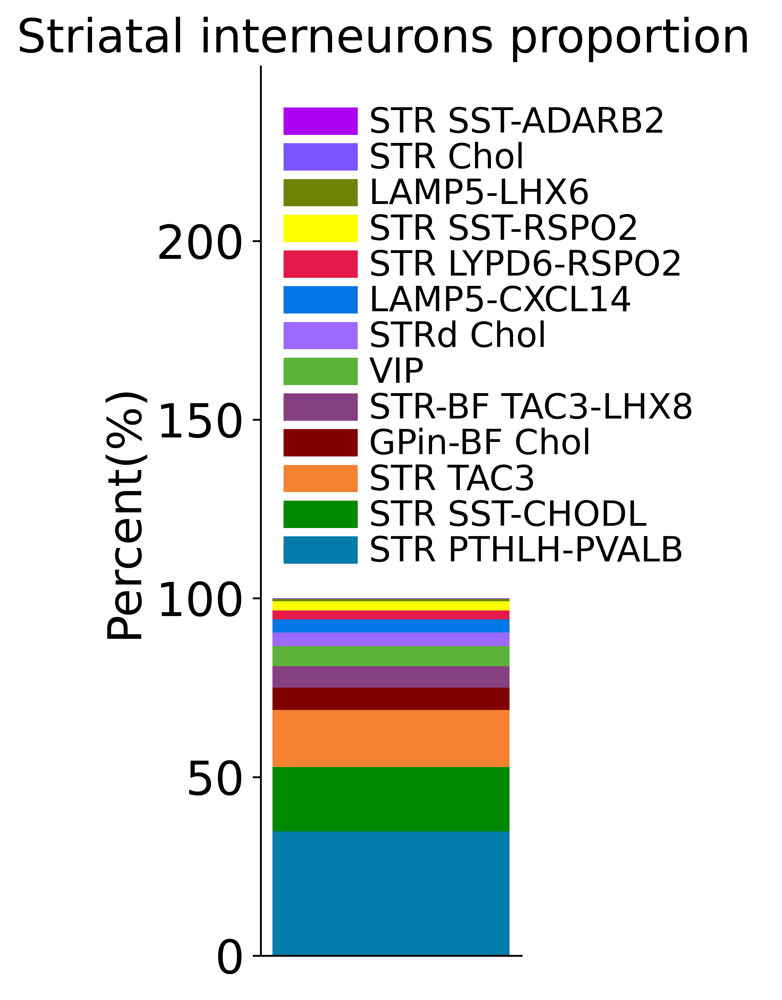

In [79]:
# stacked bar plot
import matplotlib.patches as patches
import os

fig,ax = plt.subplots(1,1, figsize = (2,7), dpi = 300)
bottom = np.zeros(CGEMGEType_fraction.shape[-1])
width = 0.99
xlabels = [CGEMGEType_fraction.columns[0]] + [x.split('_')[1] + x.split('_')[2][0] for x in CGEMGEType_fraction.columns[1:]]

for idx,type_ in enumerate(CGEMGEType_fraction.index):
    vals = CGEMGEType_fraction.loc[type_,:].values
    ax.bar(xlabels,vals,width = width ,bottom = bottom, color =cluster_cmap_shortname[type_])
    bottom += vals

ax.grid(False)
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_xticks([])
ax.set_ylabel('Percent(%)', fontdict={'fontsize': 20})
ax.set_xticks([])

ax.tick_params('y',which='major',labelsize = 20)
ax.tick_params('x',which='major',labelsize = 10)

# add legend 
bbox = ax.get_position()
for i,type_ in enumerate(CGEMGEType_fraction.index):
    rec = patches.Rectangle([bbox.xmin -  .8*bbox.width  , 110 + i* 10] , 0.3,7, color = cluster_cmap_shortname[type_], )
    ax.add_patch(rec)

    # add label 
    ax.text(bbox.xmin -  .35*bbox.width , (110 + i* 10) + 3,type_,va = 'center')


ax.set_title(f'Striatal interneurons proportion ', fontdict={'fontsize': 20})
plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'stackedbarplot_Striatal_interneuron_proportion_withlegend' + '.png',bbox_inches = 'tight')
plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'stackedbarplot_Striatal_interneuron_proportion_withlegend' + '.tif',bbox_inches = 'tight')
plt.savefig(r'./figures/Figure3/supplemental/cell_type_proportion' + os.sep + f'stackedbarplot_Striatal_interneuron_proportion_withlegend' + '.eps',bbox_inches = 'tight')
plt.show()

In [9]:
np.unique(adata_MERFISH.obs['Class_name'])

array(['Astro-Epen', 'CN CGE GABA', 'CN GABA-Glut', 'CN LGE GABA',
       'CN MGE GABA', 'Cx GABA', 'F M GABA', 'F M Glut', 'Immune',
       'M Dopa', 'OPC-Oligo', 'Vascular'], dtype=object)

In [24]:
np.unique(adata_MERFISH.obs['Final_Major_region_label'])

array(['BNST', 'Caudate', 'Ependymal_zone', 'Gpe', 'Gpi',
       'GrayMatter_fibers', 'Internal_Capsule', 'IsCj', 'NAC_core',
       'NAC_shell', 'Putamen', 'Surrounding layers', 'Thalamus',
       'anterior_commissure', 'whitematter(Olfactory area)'], dtype=object)

In [34]:
keep_cond1 = adata_MERFISH.obs['Class_name'].isin(['CN CGE GABA','CN MGE GABA'])
keep_cond2 = adata_MERFISH.obs['Final_Major_region_label'].isin(['Caudate','Putamen','NAC_core','NAC_shell'])
interneurons = adata_MERFISH[keep_cond1 & keep_cond2].obs

In [35]:
interneuron_nm,interneuron_ct = np.unique((interneurons['Group_name'].values), return_counts=True)

In [36]:
interneuron_percent = 100*(interneuron_ct/np.sum(interneuron_ct))
list(zip(interneuron_nm,interneuron_percent))

[('GPin-BF Cholinergic GABA', 6.211401425178147),
 ('LAMP5-CXCL14 GABA', 3.6460807600950123),
 ('LAMP5-LHX6 GABA', 0.6927949326999208),
 ('STR Cholinergic GABA', 0.10292953285827396),
 ('STR FS PTHLH-PVALB GABA', 34.794140934283455),
 ('STR LYPD6-RSPO2 GABA', 2.5494853523357084),
 ('STR SST-ADARB2 GABA', 0.0395882818685669),
 ('STR SST-CHODL GABA', 18.016627078384797),
 ('STR SST-RSPO2 GABA', 2.5415676959619953),
 ('STR TAC3-PLPP4 GABA', 15.942201108471894),
 ('STR-BF TAC3-PLPP4-LHX8 GABA', 6.045130641330166),
 ('STRd Cholinergic GABA', 3.820269200316706),
 ('VIP GABA', 5.59778305621536)]